# Taller #5 El Perceptron y El modelo Adaline

### Presentado por: Leonardo Sánchez
### Presentado a: Felipe Palta
### Universidad Autónoma de Occidente
### Especialización en Inteligencia Artificial

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import sklearn
import matplotlib
import sys
import random
import time
import joblib

Versiones de Python y sus librerias 

In [2]:
print("Versión de Python:", sys.version)
print(f"Version de Pandas {pd.__version__}")
print(f"Version de Numpy {pd.__version__}")
print(f"Version de Matplotlib {matplotlib.__version__}")
print(f"Version de Seaborn {sns.__version__}")
print(f"Version de Skelearn {sklearn.__version__}")
print(f"Version de joblib {joblib.__version__}")

Versión de Python: 3.10.6 (tags/v3.10.6:9c7b4bd, Aug  1 2022, 21:53:49) [MSC v.1932 64 bit (AMD64)]
Version de Pandas 1.4.3
Version de Numpy 1.4.3
Version de Matplotlib 3.5.3
Version de Seaborn 0.12.0
Version de Skelearn 1.2.2
Version de joblib 1.2.0


Cargando los datos 

In [3]:
from sklearn.datasets import load_breast_cancer

data = load_breast_cancer()

# Mostrar información sobre el conjunto de datos
print("Número de instancias:", data.data.shape[0])
print("Número de características:", data.data.shape[1])
print("Nombres de las características:", data.feature_names)
print("Clases:", data.target_names)

Número de instancias: 569
Número de características: 30
Nombres de las características: ['mean radius' 'mean texture' 'mean perimeter' 'mean area'
 'mean smoothness' 'mean compactness' 'mean concavity'
 'mean concave points' 'mean symmetry' 'mean fractal dimension'
 'radius error' 'texture error' 'perimeter error' 'area error'
 'smoothness error' 'compactness error' 'concavity error'
 'concave points error' 'symmetry error' 'fractal dimension error'
 'worst radius' 'worst texture' 'worst perimeter' 'worst area'
 'worst smoothness' 'worst compactness' 'worst concavity'
 'worst concave points' 'worst symmetry' 'worst fractal dimension']
Clases: ['malignant' 'benign']


1. Debe de realizar un EDA completo, tiene la libertad de aplicar los pasos que
considere necesario, recuerde que no hay una metodología puntual en sí,
explore los datos de tal manera que pueda realizar hipótesis y concluir
información que considere interesante.

# 1. EDA Análisis esploratorio de los datos

Creamos un dataframe 

In [4]:
# primero colocamos las caracteristicas
df = pd.DataFrame(data.data,columns=data.feature_names)

# ahora el target o clase objetivo
df["target"]= data.target

df.head(5)


,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0


Teniendo en cuenta que  

In [5]:
data.target_names

array(['malignant', 'benign'], dtype='<U9')

Los tumores malignos son la clase 1 y los benignos la clase 0.

Número de lementos por clase

In [6]:
df["target"].value_counts()

1    357
0    212
Name: target, dtype: int64

Veamos la información del dataframe  

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   mean radius              569 non-null    float64
 1   mean texture             569 non-null    float64
 2   mean perimeter           569 non-null    float64
 3   mean area                569 non-null    float64
 4   mean smoothness          569 non-null    float64
 5   mean compactness         569 non-null    float64
 6   mean concavity           569 non-null    float64
 7   mean concave points      569 non-null    float64
 8   mean symmetry            569 non-null    float64
 9   mean fractal dimension   569 non-null    float64
 10  radius error             569 non-null    float64
 11  texture error            569 non-null    float64
 12  perimeter error          569 non-null    float64
 13  area error               569 non-null    float64
 14  smoothness error         5

Vemos que no hay valores nulos y que las caracteristicas son continuas números flotantes 

In [8]:
df.isnull().sum()

mean radius                0
mean texture               0
mean perimeter             0
mean area                  0
mean smoothness            0
mean compactness           0
mean concavity             0
mean concave points        0
mean symmetry              0
mean fractal dimension     0
radius error               0
texture error              0
perimeter error            0
area error                 0
smoothness error           0
compactness error          0
concavity error            0
concave points error       0
symmetry error             0
fractal dimension error    0
worst radius               0
worst texture              0
worst perimeter            0
worst area                 0
worst smoothness           0
worst compactness          0
worst concavity            0
worst concave points       0
worst symmetry             0
worst fractal dimension    0
target                     0
dtype: int64

Ahora veamos su estadística básica 

In [9]:
df.describe()

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,0.627417
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,0.483918
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,0.000000
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,0.000000
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,1.000000
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,1.000000
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,1.000000


Revisemos cada caracteristica del data set, teniendo encuenta que. 

+ x medio: Representa el promedio de todos los x medidos para cada núcleo celular.
+ x worst: Se centra en los valores extremos, específicamente los más grandes. Al promediar los tres x más grandes, captura las características más prominentes de la forma del núcleo.
con x igual a radio, textura etc.

Consignemos las caracteristicas en una tabla con su descripción: 

| Característica              | Descripción     | Tipo de Variable |                                                                           
|:-----------------------------|:-----------------|:------------------|
| mean radius                 | Promedio del radio de las células.                                                                                                      | Continua, real>0     |
| mean texture                | Promedio de la textura de las células.                                                                                                  | Continua, real>0         |
| mean perimeter              | Promedio del perímetro de las células.                                                                                                  | Continua, real>0         |
| mean area                   | Promedio del área de las células.                                                                                                       | Continua, real>0         |
| mean smoothness             | Suavidad promedio de las células.                                                                                                       | Continua, real>0         |
| mean compactness            | Compacidad o circularidad promedio de las células.                                                                                                     | Continua, real>0         |
| mean concavity              | Concavidad promedio de las células.                                                                                                     | Continua, real>0         |
| mean concave points         | Número promedio de puntos cóncavos en las células.                                                                                      | Continua, real>0         |
| mean symmetry               | Simetría promedio de las células.                                                                                                       | Continua, real>0         |
| mean fractal dimension      | Dimensión fractal promedio de las células.                                                                                              | Continua, real>0         |
| radius error                | Error estándar del radio de las células.                                                                                                | Continua, real>0         |
| texture error               | Error estándar de la textura de las células.                                                                                            | Continua, real>0         |
| perimeter error             | Error estándar del perímetro de las células.                                                                                            | Continua, real>0         |
| area error                  | Error estándar del área de las células.                                                                                                 | Continua, real>0         |
| smoothness error            | Error estándar de la suavidad de las células.                                                                                           | Continua, real>0         |
| compactness error           | Error estándar de la compacidad de las células.                                                                                         | Continua, real>0         |
| concavity error             | Error estándar de la concavidad de las células.                                                                                         | Continua, real>0         |
| concave points error        | Error estándar del número de puntos cóncavos en las células.                                                                            | Continua, real>0         |
| symmetry error              | Error estándar de la simetría de las células.                                                                                           | Continua, real>0         |
| fractal dimension error     | Error estándar de la dimensión fractal de las células.                                                                                  | Continua, real>0         |
| worst radius                | Valor  extremo del radio de las células.                                                                                                    | Continua, real>0         |
| worst texture               | Valor  extremo de la textura de las células.                                                                                                | Continua, real>0         |
| worst perimeter             | Valor  extremo del perímetro de las células.                                                                                                | Continua, real>0         |
| worst area                  | Valor  extremo del área de las células.                                                                                                     | Continua, real>0         |
| worst smoothness            | Valor  extremo de la suavidad de las células.                                                                                               | Continua, real>0         |
| worst compactness           | Valor  extremo de la compacidad de las células.                                                                                             | Continua, real>0         |
| worst concavity             | Valor  extremo de la concavidad de las células.                                                                                             | Continua, real>0         |
| worst concave points        | Valor  extremo del número de puntos cóncavos en las células.                                                                                | Continua, real>0         |
| worst symmetry              | Valor  extremo de la simetría de las células.                                                                                               | Continua, real>0         |
| worst fractal dimension     | Valor  extremo de la dimensión fractal de las células.                                                                                      | Continua, real>0         |
| target                      | Variable objetivo indicando la clase del tumor (0: benigno, 1: maligno).                                                                 | Categórica       |


Ya entendiendo las descripción de cada caracteristica y su tipo, pasamos a graficar sus histogramas, de primera mano usando la función hist() 


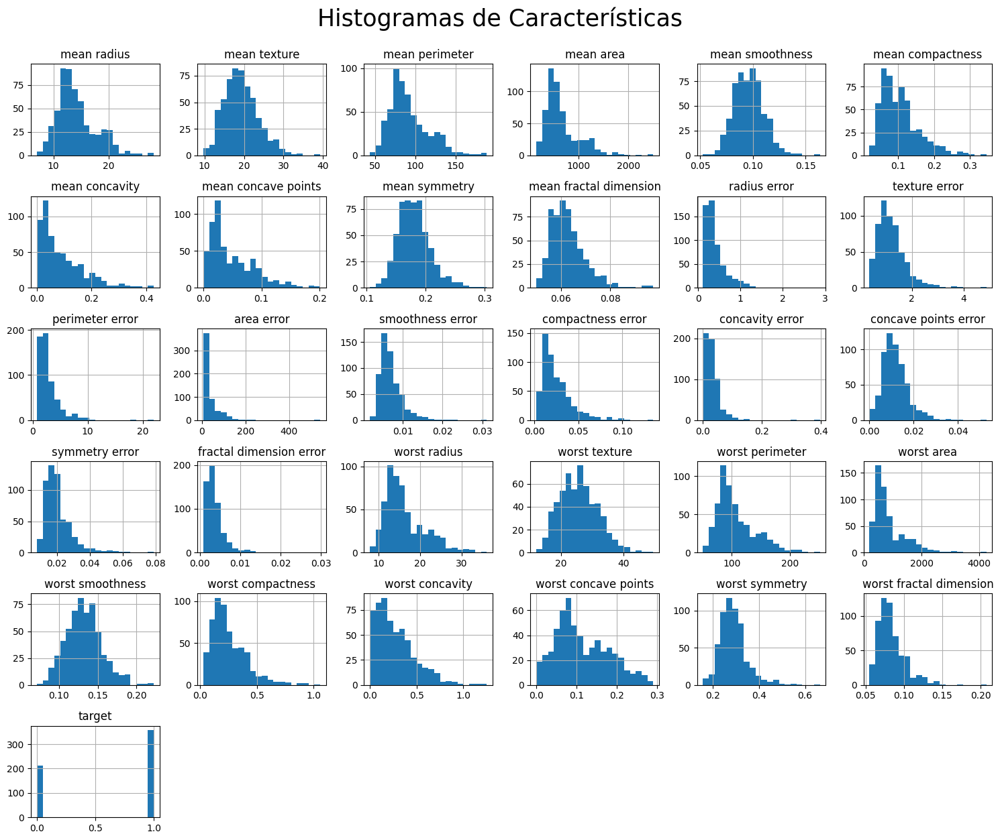

In [10]:
df.hist(figsize=(15, 12),bins=20)  # Organiza los histogramas en una cuadrícula de 6 filas y 5 columnas
plt.tight_layout()  # Ajusta automáticamente los subplots para evitar solapamientos
plt.suptitle("Histogramas de Características", fontsize=25, x=0.5, y=1.04)  # Título global
plt.show()

Ahora teniendo en cuenta las clases con Seaborn 

In [11]:
columnas = df.columns[:-1]
columnas

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension'],
      dtype='object')

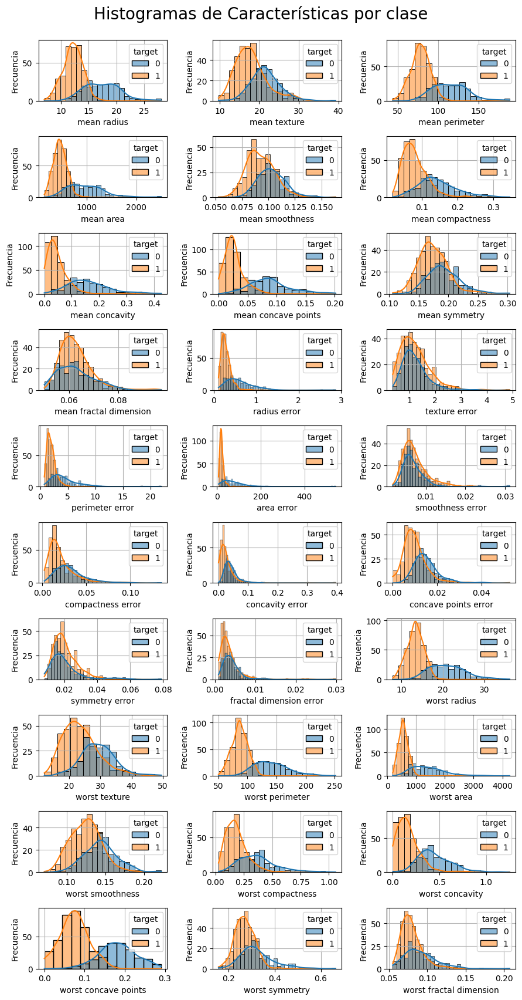

In [12]:
fig, ax = plt.subplots(10,3,figsize=(9, 17))
ax=ax.ravel()
for indice, caracteristica in enumerate(columnas):
    sns.histplot(data=df, x=caracteristica, hue='target', ax=ax[indice],kde="True")
    ax[indice].grid(True)
    ax[indice].set_ylabel("Frecuencia")
plt.suptitle("Histogramas de Características por clase", fontsize=20, x=0.5, y=1)  # Título global
plt.tight_layout()

Del diagrama anterior vemos que no hay una verdadera separabilidad entre clases para cada caracteristica, ya que se, superponen sus diagramas de distribución

Ahora veremos el balanceo de clases y sus porcentajes

In [13]:
conteo_clases = df["target"].value_counts()
conteo_clases

1    357
0    212
Name: target, dtype: int64

In [14]:
porcentaje_clases = df["target"].value_counts(normalize=True) * 100
porcentaje_clases

1    62.741652
0    37.258348
Name: target, dtype: float64

In [15]:
print(f"El numero de tumores bebignos clase 0 es:\n{conteo_clases[0]}\n\
Su porcentaje en el total es:\n{porcentaje_clases[0]:.2f}%")

print(f"\n\nEl numero de tumores malignos clase 1 es:\n{conteo_clases[1]}\n\
Su porcentaje en el total es:\n{porcentaje_clases[1]:.2f}%")

El numero de tumores bebignos clase 0 es:
212
Su porcentaje en el total es:
37.26%


El numero de tumores malignos clase 1 es:
357
Su porcentaje en el total es:
62.74%


Por tanto, no hay balanceo de clases, grafiquemos su histograma.

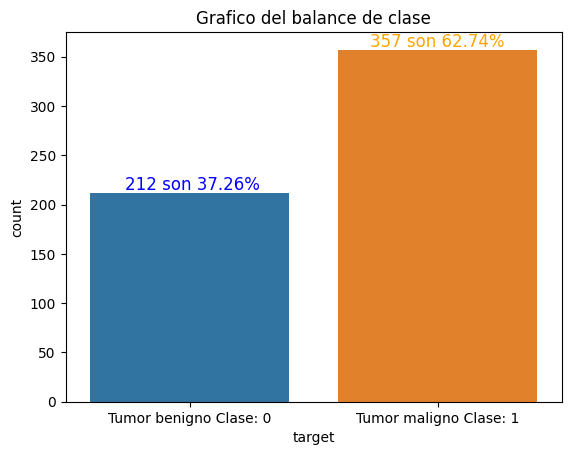

In [16]:

sns.countplot(data=df, x='target')
plt.title("Grafico del balance de clase")
plt.xticks([0, 1], ['Tumor benigno Clase: 0', 'Tumor maligno Clase: 1'])
plt.text(0.01, 215, '212 son 37.26%', fontsize=12, ha='center',color='blue')
plt.text(1.0, 360, '357 son 62.74%', fontsize=12, ha='center',color='orange')
plt.show()

Ya teniendo los histogramas y el balance de clases podemos realizar un grafico de cajas pare ver los valores atipicos

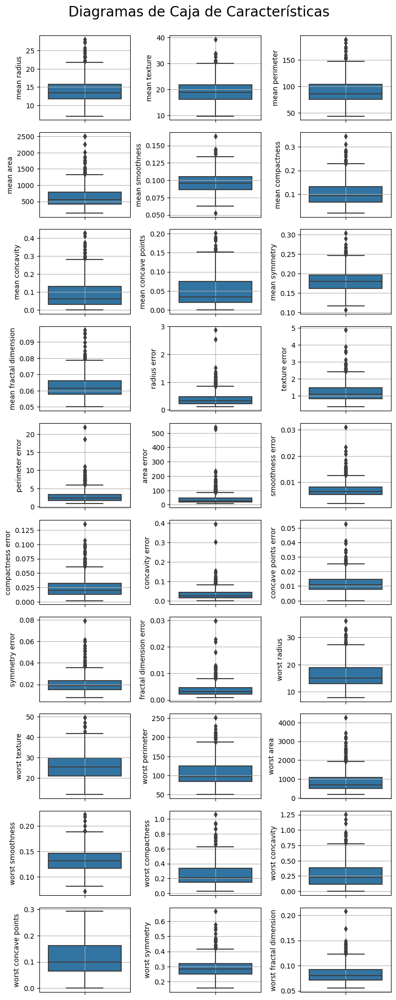

In [17]:
fig, ax = plt.subplots(10, 3, figsize=(8, 20))
ax = ax.ravel()

for indice, caracteristica in enumerate(columnas):
    sns.boxplot(data=df, y=caracteristica, ax=ax[indice])
    ax[indice].grid(True)
    ax[indice].set_ylabel(caracteristica)

plt.suptitle("Diagramas de Caja de Características", fontsize=20, x=0.5, y=1.0)
plt.tight_layout()
plt.show()


Vemos en casi todas las caracteristicas hay puntos anomalos o atipicos, grafiquemosslo por clase

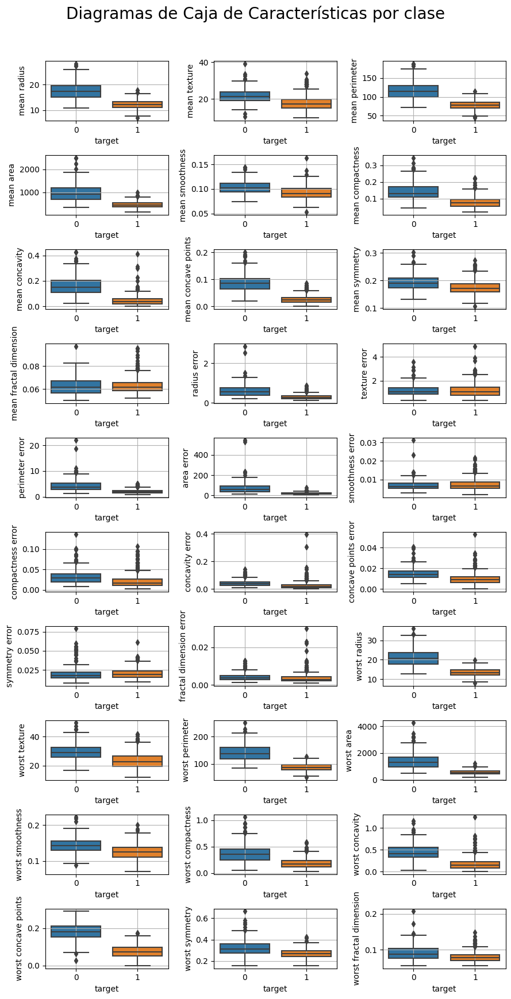

In [18]:
fig, ax = plt.subplots(10, 3, figsize=(9, 17))
ax = ax.ravel()

for indice, caracteristica in enumerate(columnas):
    sns.boxplot(data=df, y=caracteristica, x='target', ax=ax[indice])
    ax[indice].grid(True)
    ax[indice].set_ylabel(caracteristica)

plt.suptitle("Diagramas de Caja de Características por clase", fontsize=20, x=0.5, y=1.02)
plt.tight_layout()
plt.show()


Vemos en los graficos de cajas que tanto la clase 0 como la clase 1 presenta datos anomalos.

Teniendo en cuenta el desconocimiento del comportamiento de los datos en cuento a variabilidad, ademas, de su importancia 
no podemos eliminar estos puntos anomalos, ya que puede ser inerente al mismo proceso.

Por otro lado, ya que los modelos a entrenar buscan una separabilidad lineal del conjunto vamos a generar el grafico pair plot de estos.

In [19]:
sns.pairplot(df,hue="target")
plt.show()

Ya que son 30 caracteristicas, el grafico es inviable de ver, por tanto, tomaremos grupos aleatorios de 6 y los graficaremos.

Lista de caracteristicas aleatorias
 ['worst compactness', 'mean symmetry', 'worst texture', 'worst concave points', 'radius error', 'mean perimeter', 'target']


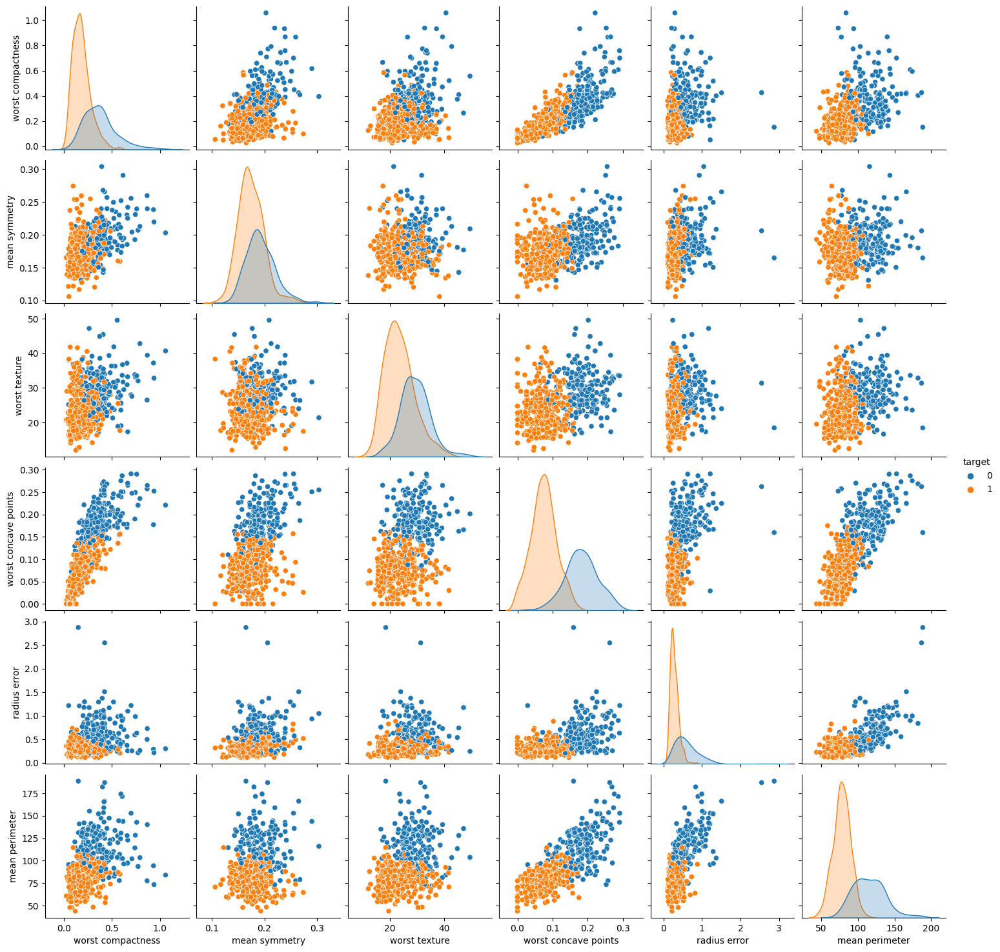

Lista de caracteristicas aleatorias
 ['worst concavity', 'smoothness error', 'mean perimeter', 'mean texture', 'texture error', 'mean fractal dimension', 'target']


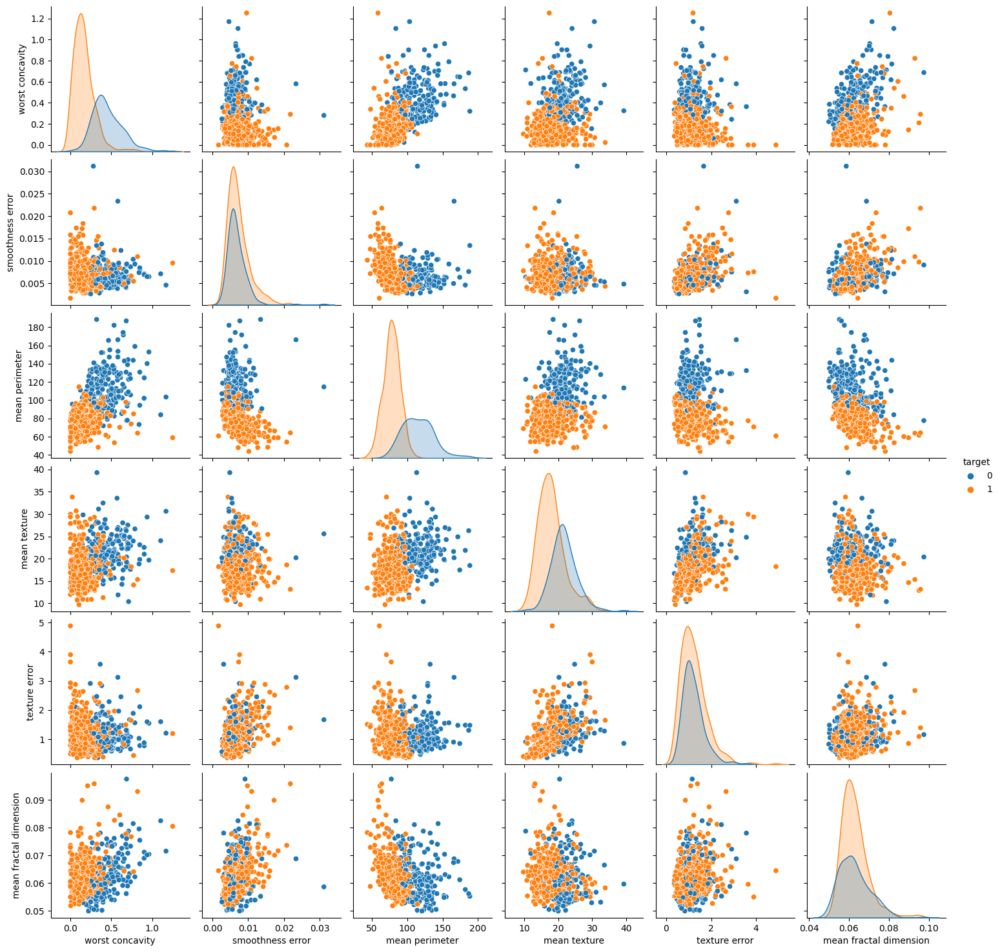

Lista de caracteristicas aleatorias
 ['mean fractal dimension', 'compactness error', 'smoothness error', 'mean area', 'worst smoothness', 'perimeter error', 'target']


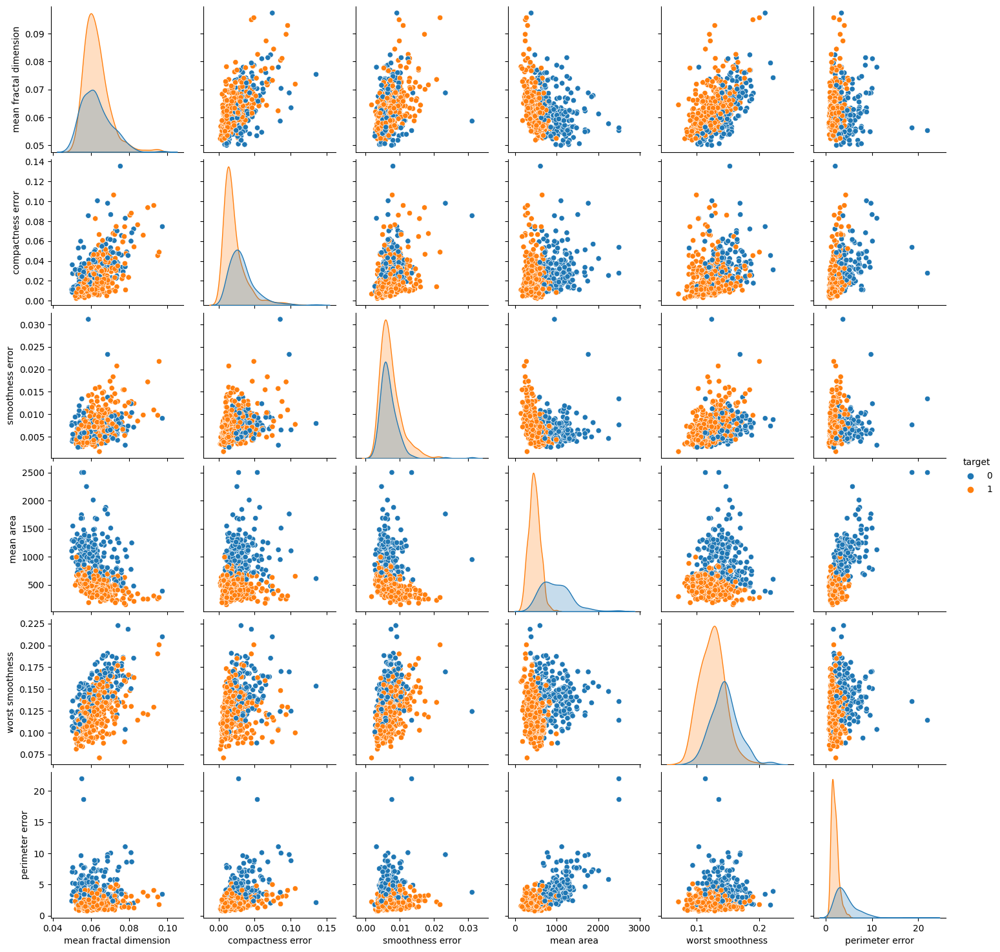

Lista de caracteristicas aleatorias
 ['mean perimeter', 'worst compactness', 'worst texture', 'worst symmetry', 'mean smoothness', 'mean fractal dimension', 'target']


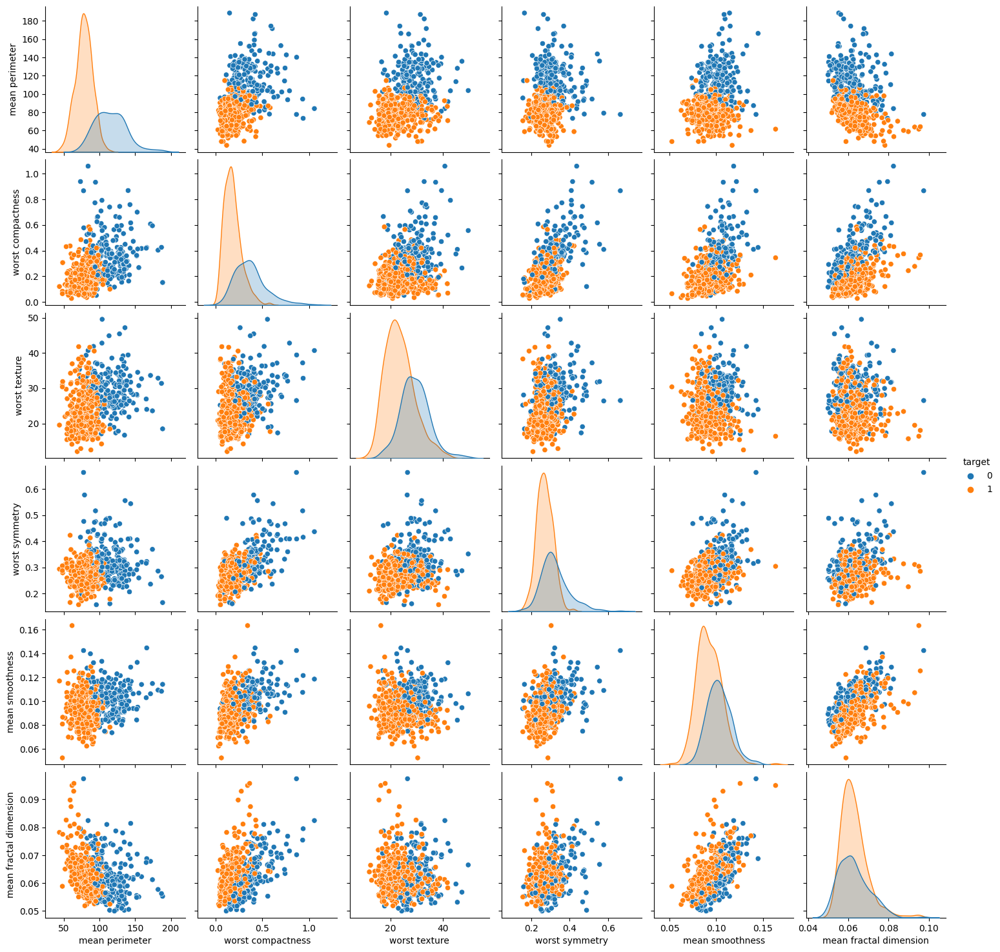

Lista de caracteristicas aleatorias
 ['concave points error', 'worst texture', 'mean fractal dimension', 'worst smoothness', 'worst concave points', 'radius error', 'target']


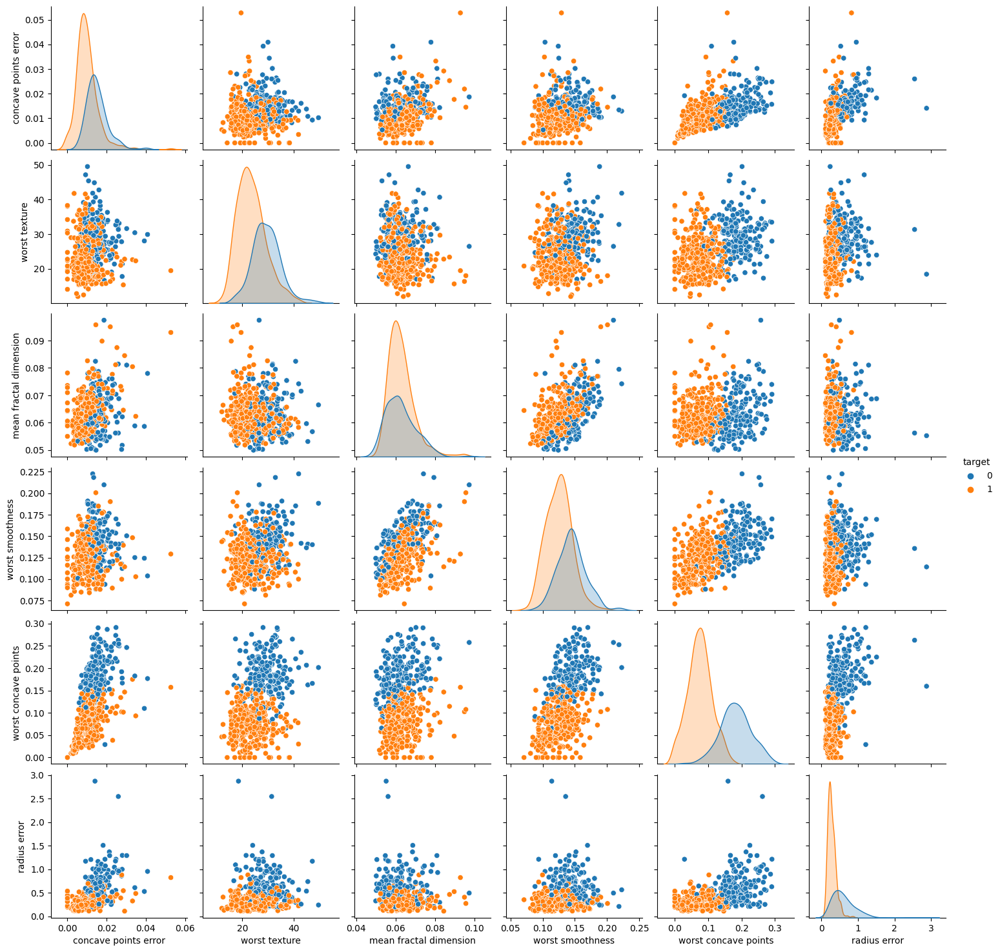

Lista de caracteristicas aleatorias
 ['worst area', 'mean compactness', 'worst concavity', 'mean perimeter', 'mean fractal dimension', 'radius error', 'target']


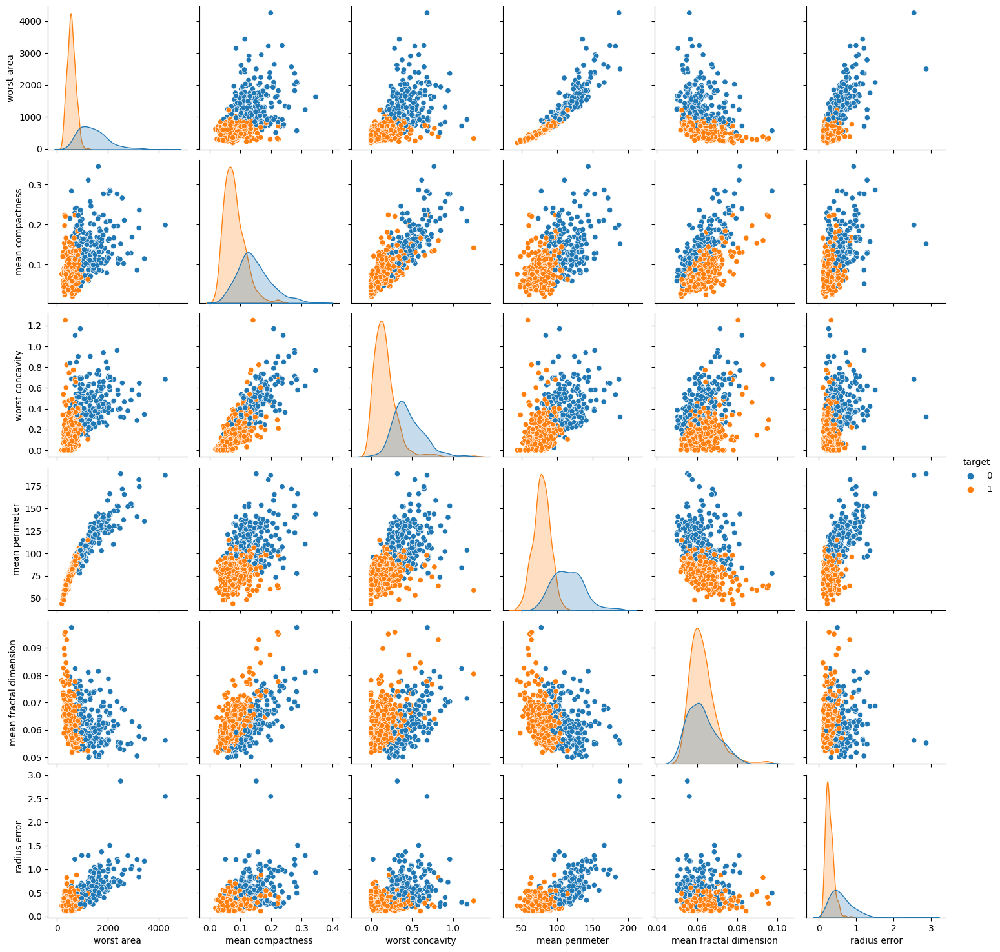

Lista de caracteristicas aleatorias
 ['mean symmetry', 'mean smoothness', 'smoothness error', 'mean area', 'radius error', 'perimeter error', 'target']


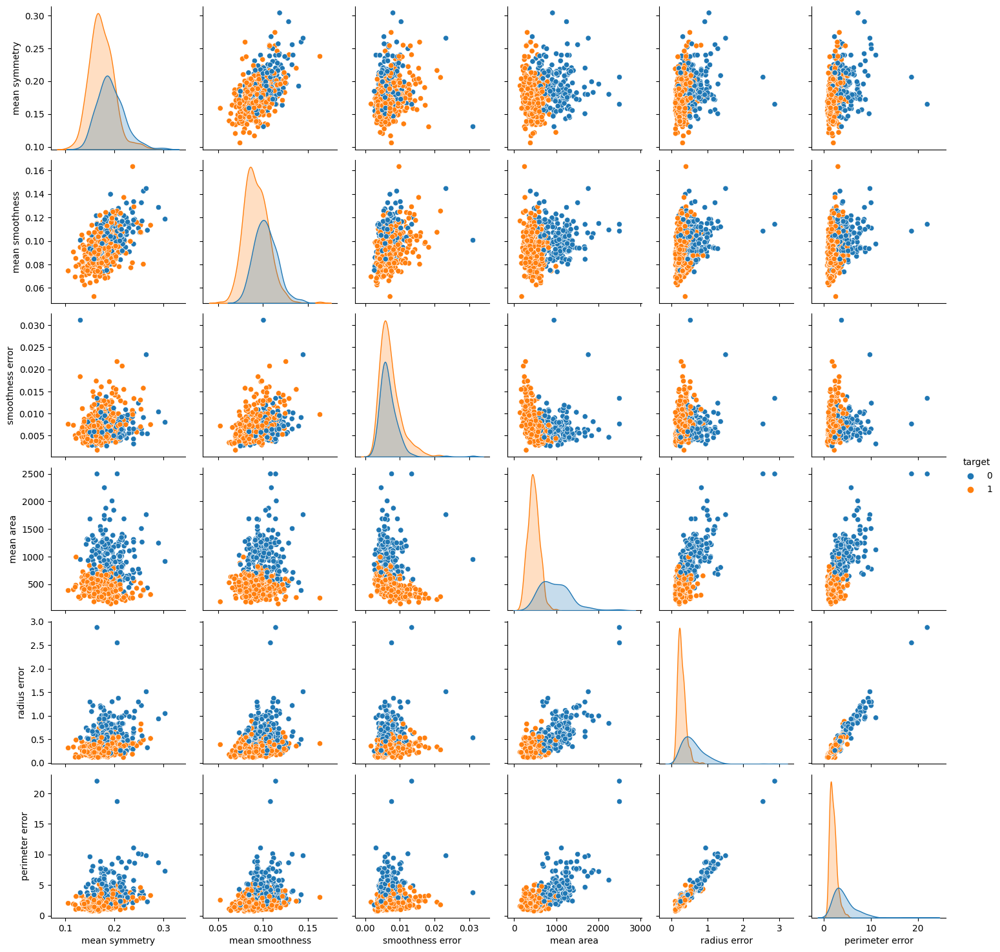

Lista de caracteristicas aleatorias
 ['texture error', 'fractal dimension error', 'worst concave points', 'mean area', 'mean texture', 'worst fractal dimension', 'target']


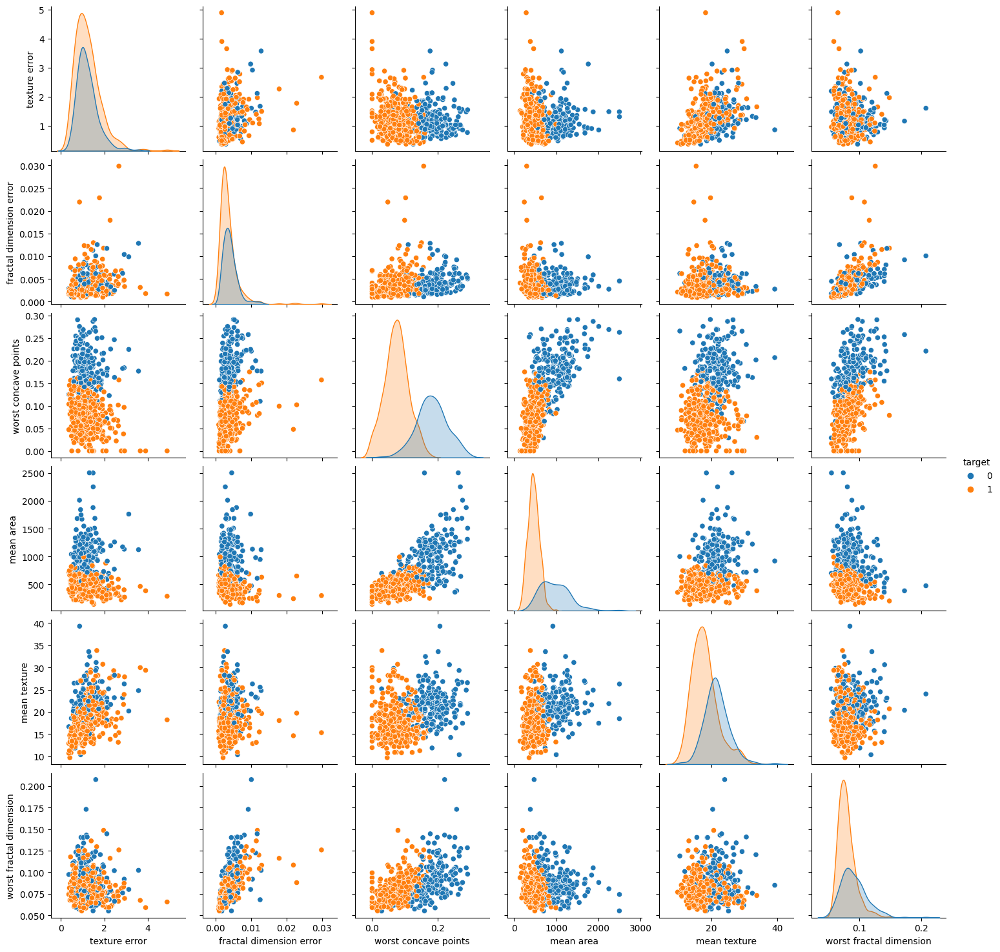

In [20]:
# Seleccionar aleatoriamente 6 características

for i in range(8):
    caracteristicas_seleccionadas = random.sample(columnas.to_list(), 6)+["target"]
    print("Lista de caracteristicas aleatorias\n",caracteristicas_seleccionadas)
    sns.pairplot(df[caracteristicas_seleccionadas],hue="target")
    plt.show()




Del grafico de pair plor vemos que algunos pares presentan casi una separabilidad, por ejemplo, worst smoothness con mean area y works area.

Pero este método grafico de encontrar el par de caracteristicas no es muy bueno, ya que son mucho graficos. 

Por lo tanto, se aplicaran algunos métodos de filtrado para la selección de par de caracteristicas.

Iniciamos calculando la matrzi de correlación

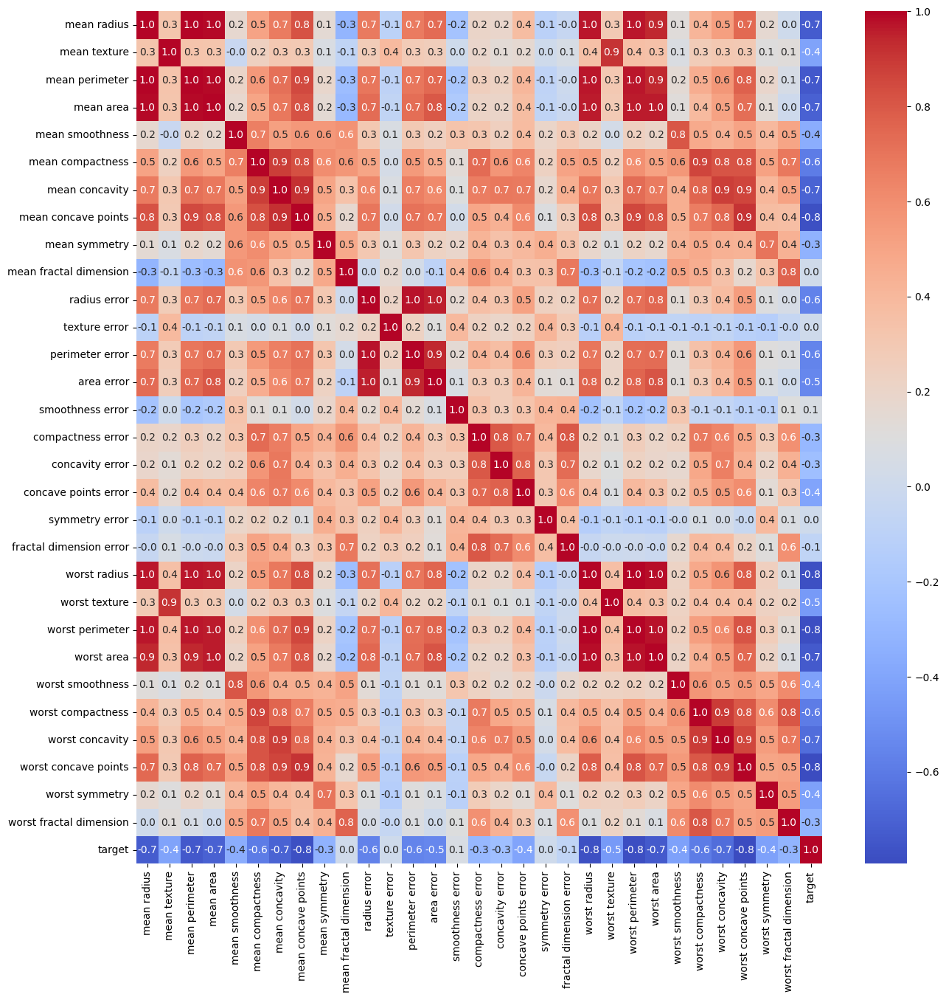

In [21]:
plt.figure(figsize=(15,15))
sns.heatmap(df.corr(),annot=True,cmap='coolwarm',fmt=".1f")
plt.show()

En la salida anterior del mapa de calor podemos observa que hay algnbos valores de correlación muy altos incluso de 1, como el radio con el diametro y el perimetro. Lo que nos lleva a saber que estas variables dan información redundate, y es logico debido a que el area y el perimetro dependen del radió. Sin embargo no, es suficiente para escojer dos variables, por eso utilizaremos la **importancia mutua**, la cual, mide cuanta información de la variable objetivo se puede extraer a partir de una caracteristica dada utilizando la entropia.

Para esto generamos la matriz de caracteristicas y la variable objetivo.

In [22]:
X = df[columnas]
y = df["target"]

Ahora calculamos la importancia mutua

In [23]:
# Importa la función de selección de características
from sklearn.feature_selection import mutual_info_classif
feature_scores = mutual_info_classif(X, y, discrete_features='auto', random_state=42)
feature_scores


array([0.36227577, 0.09653954, 0.40236081, 0.36002335, 0.07973979,
       0.21343943, 0.37544687, 0.43880645, 0.06572069, 0.00588801,
       0.2493009 , 0.        , 0.27561421, 0.34075905, 0.01565132,
       0.07339016, 0.11743972, 0.12541455, 0.01421579, 0.03923534,
       0.45123003, 0.12033132, 0.47184229, 0.46431329, 0.09569708,
       0.22521115, 0.31525939, 0.43625482, 0.09543477, 0.0650413 ])

In [24]:
# Crea un DataFrame para visualizar las puntuaciones de importancia mutua por característica
feature_scores_df_mutua = pd.DataFrame({'Feature': X.columns, 'Mutual_Info_Score': feature_scores})
feature_scores_df_mutua = feature_scores_df_mutua.sort_values(by='Mutual_Info_Score', ascending=False)
feature_scores_df_mutua

,Feature,Mutual_Info_Score
22,worst perimeter,0.471842
23,worst area,0.464313
20,worst radius,0.451230
7,mean concave points,0.438806
27,worst concave points,0.436255
2,mean perimeter,0.402361
6,mean concavity,0.375447
0,mean radius,0.362276
3,mean area,0.360023
13,area error,0.340759


Ya teniendo las puntuaciones de la información mutua, grafiquemoslo: 

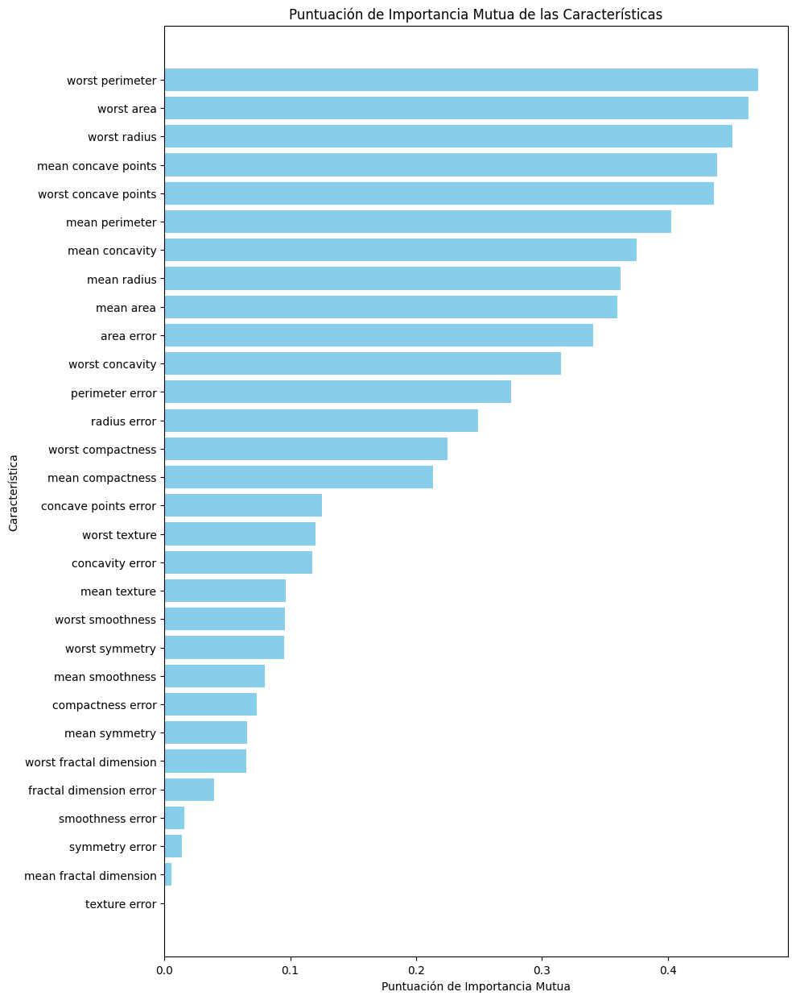

In [25]:
# Gráfica de barras de las puntuaciones de importancia mutua
plt.figure(figsize=(10, 15))
plt.barh(feature_scores_df_mutua['Feature'], feature_scores_df_mutua['Mutual_Info_Score'], color='skyblue')
plt.xlabel('Puntuación de Importancia Mutua')
plt.ylabel('Característica')
plt.title('Puntuación de Importancia Mutua de las Características')
plt.gca().invert_yaxis()  # Invierte el orden de las características para mostrar la más importante en la parte superior
plt.show()

Se observa que las caracteristicas con mayor información mutua son worst perimeter y worts area, sim embargo, vemos en el mapa de correlación  una correlación de 1, lo que significa que la información es redundante, es decir que una sola variable seria suficiente, por tanto, el candidato para el par de valores es worst perimeter y mean concavity, ya que tienen una importancia mutua de 0.471842 y 0.375447, con una correlación de 0.7, lo que significa que ambas aportan información un tanto diferente no tan redundante.

Ahora vamos a utilizar el metodo VarianceThreshold, que basa la importancia de la caracteristica en la varianza de las variables caracteristicas 

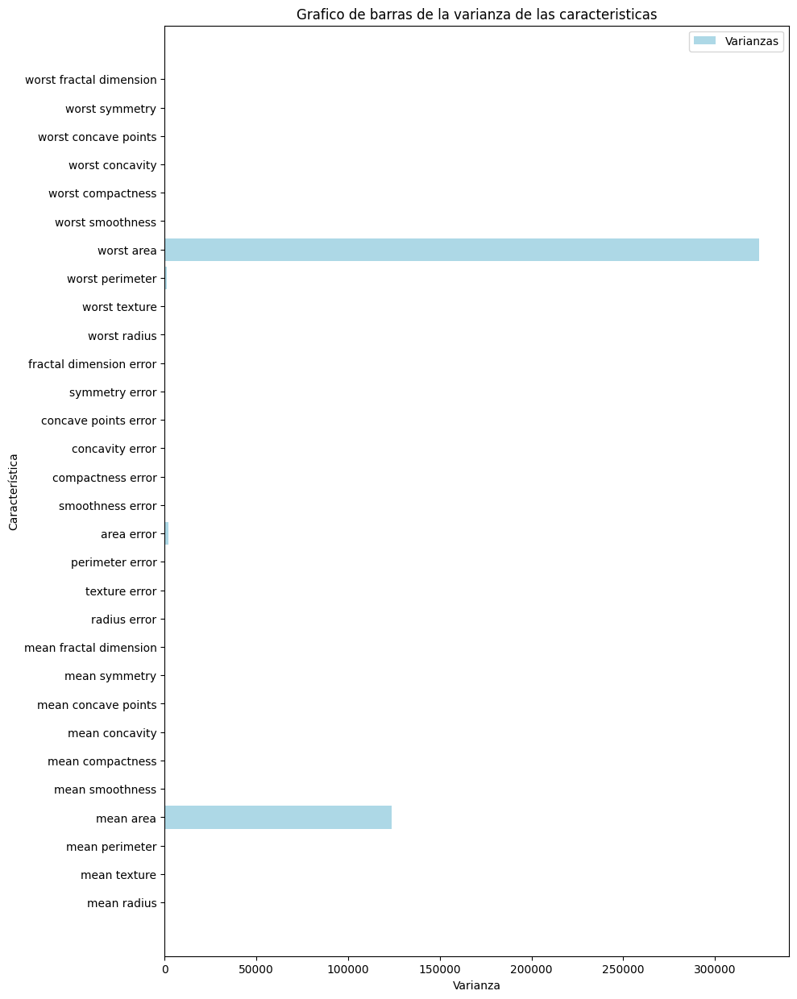

In [26]:
from sklearn.feature_selection import VarianceThreshold
# Calcular la varianza de cada característica 
variances_before = X.var()

variance_selector = VarianceThreshold()

# Ajustar el selector a tus datos
X_high_variance = variance_selector.fit_transform(X)

# Obtener las características seleccionadas
selected_features = X.columns[variance_selector.get_support()]

# Calcular la varianza de cada característica después de aplicar el umbral
variances_after = X[selected_features].var()

# Crear un gráfico para comparar la varianza 

plt.figure(figsize=(10, 15))
plt.barh(X.columns, variances_before, color='lightblue', label='Varianzas')
plt.xlabel('Varianza')
plt.ylabel('Característica')

plt.legend()

plt.title("Grafico de barras de la varianza de las caracteristicas")
# Mostrar el gráfico
plt.show()




En la salida anterior vemos que las caracteristicas es mayor en worst area y mean area que tiene una correlación muy alta, mientras que, las otras no se ven mucho por tanto, las eliminamos las que tienen una alta correlación con estas y las graficamos de nuevo 

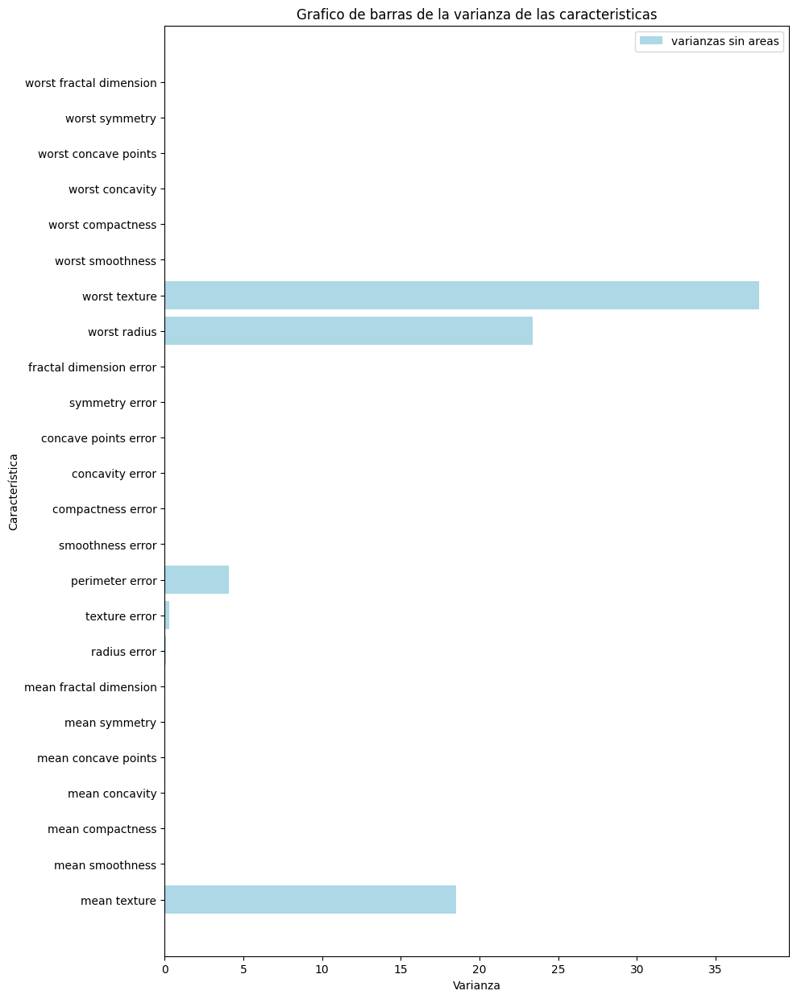

In [27]:
lista = ['mean texture',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension']

# Calcular la varianza de cada característica 
variances_before = X[lista].var()

variance_selector = VarianceThreshold()

# Ajustar el selector a tus datos
X_high_variance = variance_selector.fit_transform(X)

# Obtener las características seleccionadas
selected_features = X.columns[variance_selector.get_support()]

# Calcular la varianza de cada característica después de aplicar el umbral
variances_after = X[selected_features].var()

# Crear un gráfico para comparar la varianza 

plt.figure(figsize=(10, 15))
plt.barh(X[lista].columns, variances_before, color='lightblue', label='varianzas sin areas')
plt.xlabel('Varianza')
plt.ylabel('Característica')

plt.legend()

plt.title("Grafico de barras de la varianza de las caracteristicas")
# Mostrar el gráfico
plt.show()



Teniendo en cuenta lo anterior el para seleccionado podria ser worst area y worst texture que tienen una correlación de 0.3.


Por ultimo, se utilizara el Fisher's score que en el contexto de la selección de caracteristicas mide la relación de la variable objetivo y las caract3eristicas siendo :

Hipotesis nula $H_0$ no hay relación entre la variabel objetivo y la variable caracteristica, significa que la media de la caracteristica es la misma para todas las categorias 

Hipotesis alternativa $H_1$ si hay relación entre la caracteristica y el objetivo, significa que la media para cada categoria es diferente.


Por tanto, un puntaje de Fisher's alto y un p valor bajo indica que la caracteristica es revevante o importante para pr3edecir la variable objetivo.



,Feature,Fisher_Score,P-Value
27,worst concave points,964.385393,1.969100e-124
22,worst perimeter,897.944219,5.771397e-119
7,mean concave points,861.676020,7.101150e-116
20,worst radius,860.781707,8.482292e-116
2,mean perimeter,697.235272,8.436251e-101
23,worst area,661.600206,2.828848e-97
0,mean radius,646.981021,8.465941e-96
3,mean area,573.060747,4.734564e-88
6,mean concavity,533.793126,9.966556e-84
26,worst concavity,436.691939,2.464664e-72


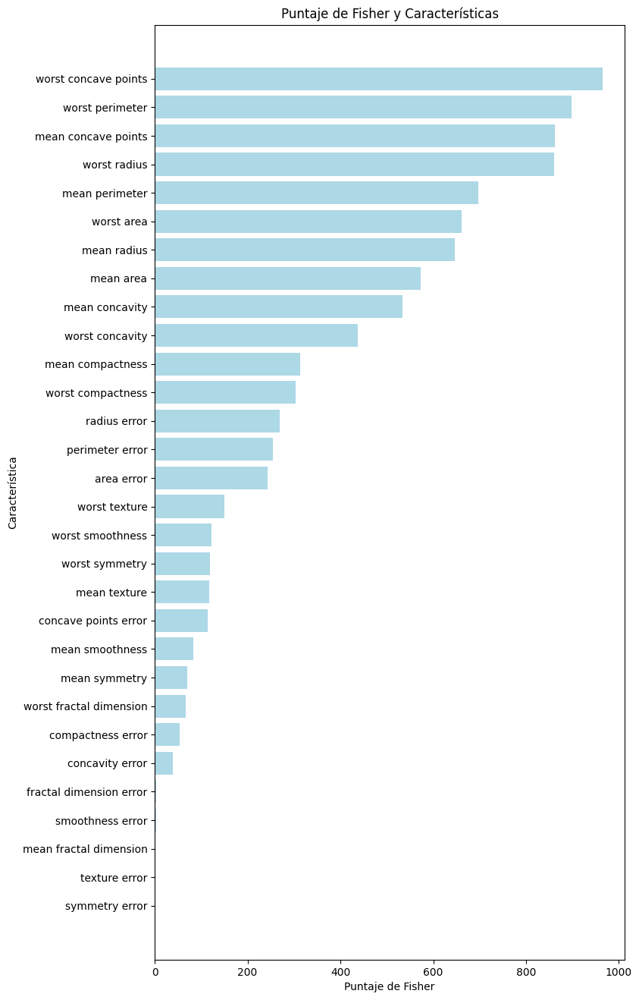

In [28]:
from sklearn.feature_selection import f_classif

# Calcular el puntaje de Fisher
f_scores, p_values = f_classif(X, y)

# Crear un DataFrame para visualizar los puntajes de Fisher
fisher_scores_df = pd.DataFrame({'Feature': X.columns, 'Fisher_Score': f_scores, 'P-Value': p_values})

# Ordenar por puntaje de Fisher en orden descendente
fisher_scores_df = fisher_scores_df.sort_values(by='Fisher_Score', ascending=False)

# Visualizar la tabla de resultados
display(fisher_scores_df)

# Crear una figura y ejes para graficar los puntajes de Fisher
plt.figure(figsize=(8, 16))
ax = plt.gca()

# Barra para todas las características
plt.barh(fisher_scores_df['Feature'], fisher_scores_df['Fisher_Score'], color='lightblue')
plt.xlabel('Puntaje de Fisher')
plt.ylabel('Característica')
plt.title('Puntaje de Fisher y Características')

# Invertir el orden de las características para mostrar la más importante en la parte superior
ax.invert_yaxis()

# Mostrar el gráfico
plt.show()

Si miramos un par seria worst concave points y worst perimeter cuya correlación es 0.6.


Resumamos los pares obtenidos:
* metodo de importancia mutua worst perimeter y mean concavity correlación de 0.7
* metodo de la varianza worst area y worst texture correlación de 0.3
* metodo de Fisher worst concave points y worst perimeter correlación de 0.6
    
    

Veamos sus correlaciones entre ellas 

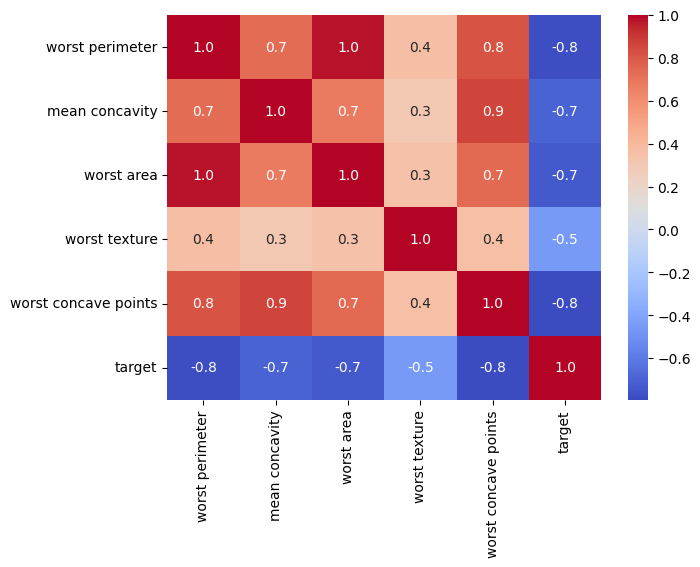

In [29]:
pares = df[['worst perimeter','mean concavity','worst area',
            'worst texture','worst concave points',"target"]].corr()
plt.figure(figsize=(7,5))
sns.heatmap(pares,annot=True,cmap='coolwarm',fmt=".1f")
plt.show()

realizemos tambien el pair plot

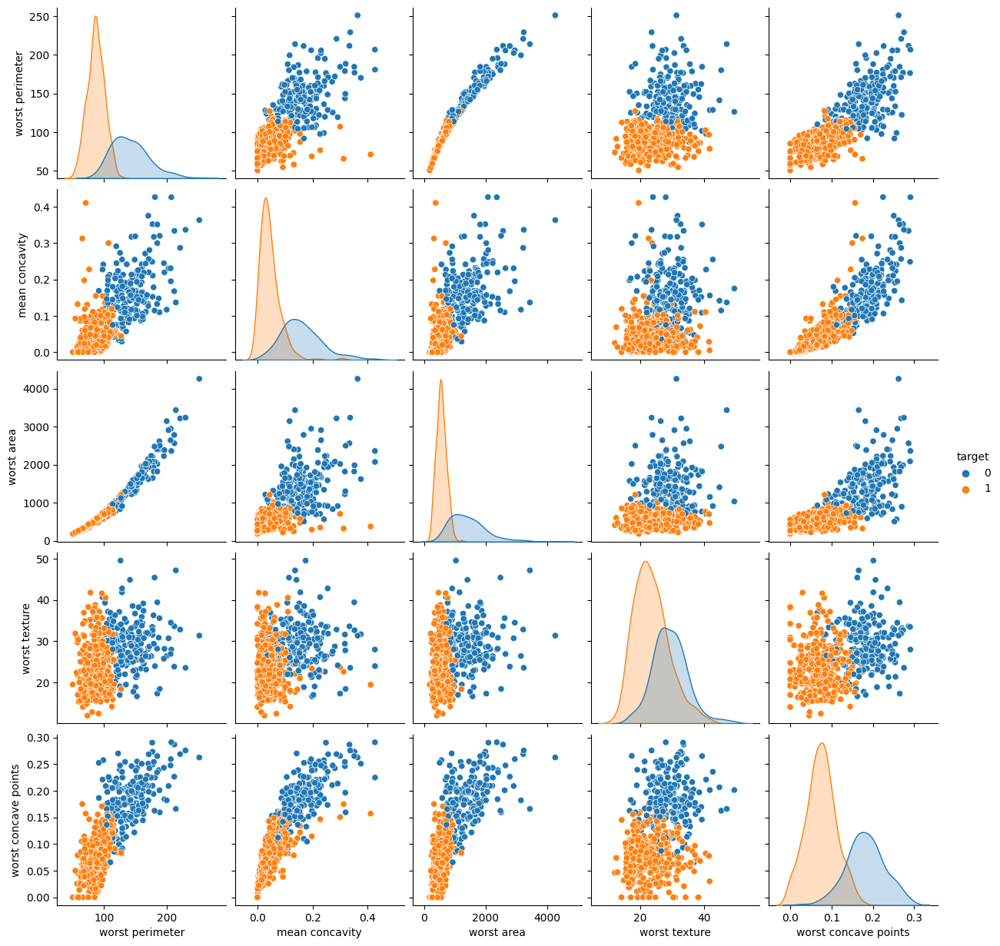

In [30]:
df_reducido = df[['worst perimeter','mean concavity','worst area',
            'worst texture','worst concave points',"target"]].copy()

sns.pairplot(df_reducido,hue="target")
plt.show()

Finalmente observando la correlación, asi como, la separabilidad de los pares se escoje el par:
**worst texture y worst perimeter** correlación de 0.4
    

2. Seleccione dos características que a su juicio usted considere (resultado del
EDA previamente realizado) tienen una tendencia de separación lineal. Tenga
que presente que como en la vida real, la separación lineal lo más probable es
que no exista (como si en el Iris Dataset, por ejemplo), por tanto, no sea
exegético al tratar de buscar una separación lineal perfecta, puesto que no la
va a encontrar, por el contrario, seleccione las características que considere
tengan dicha tendencia de separación lineal, preparando estos datos para ser
clasificados posteriormente por un Perceptron y Adaline (Que como ya se sabe,funcionan muy bien para separar distribuciones de datos que tienen una
separación lineal).

# 2. Sellección de caracteristicas  
Las caracteristicas seleccionadas del analisis anterior son:
**worst texture y worst perimeter**

Su separabilidad es casi lineal y son caracteristicas relevantes grafiquemoslo.



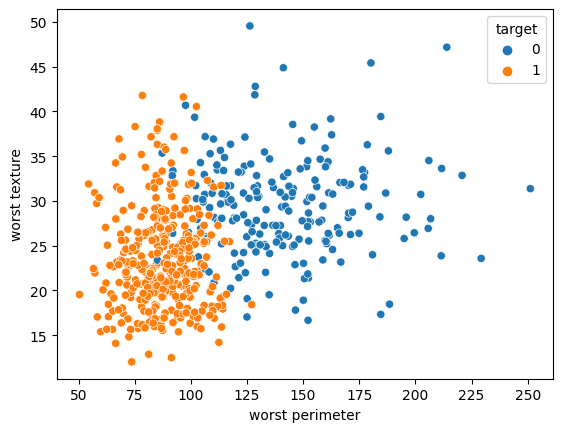

In [31]:
par_seleccionado = df_reducido[['worst perimeter','worst texture',"target"]].copy()

sns.scatterplot(data=par_seleccionado, x='worst perimeter', y='worst texture', hue='target')
plt.show()

3. Extraiga entonces y cree su matriz de características X y vector de objetivos y.
Tenga listo su vector y saturado tanto en forma de que los datos puedan ser
entrenados con una función de activación escalón binario bipolar y unipolar.

# 3. matriz de caracteristicas y vector objetivo  
Para esto utilizamos el dataframe par_seleccionado, que tien el par de variables caracteristicas seleccionadas y el target 

In [32]:
X_par_selec = par_seleccionado[['worst perimeter','worst texture']].values
y_unipolar = par_seleccionado['target'].values

# ahora la bipolar 

y_bipolar = par_seleccionado['target'].replace(0 , -1).values

In [33]:
print(f"Matriz de caracteristicas\n{X_par_selec}\n")
print(f"matriz objetivo unipolar\n{y_unipolar}\n")
print(f"matriz objetivo bipolar\n{y_bipolar}\n")

Matriz de caracteristicas
[[184.6   17.33]
 [158.8   23.41]
 [152.5   25.53]
 ...
 [126.7   34.12]
 [184.6   39.42]
 [ 59.16  30.37]]

matriz objetivo unipolar
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 1 0 1 1 1 1 1 0 0 1 0 0 1 1 1 1 0 1 0 0 1 1 1 1 0 1 0 0
 1 0 1 0 0 1 1 1 0 0 1 0 0 0 1 1 1 0 1 1 0 0 1 1 1 0 0 1 1 1 1 0 1 1 0 1 1
 1 1 1 1 1 1 0 0 0 1 0 0 1 1 1 0 0 1 0 1 0 0 1 0 0 1 1 0 1 1 0 1 1 1 1 0 1
 1 1 1 1 1 1 1 1 0 1 1 1 1 0 0 1 0 1 1 0 0 1 1 0 0 1 1 1 1 0 1 1 0 0 0 1 0
 1 0 1 1 1 0 1 1 0 0 1 0 0 0 0 1 0 0 0 1 0 1 0 1 1 0 1 0 0 0 0 1 1 0 0 1 1
 1 0 1 1 1 1 1 0 0 1 1 0 1 1 0 0 1 0 1 1 1 1 0 1 1 1 1 1 0 1 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 1 1 1 1 1 1 0 1 0 1 1 0 1 1 0 1 0 0 1 1 1 1 1 1 1 1 1 1 1 1
 1 0 1 1 0 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 0 1 0 1 1 1 1 0 0 0 1 1
 1 1 0 1 0 1 0 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 1 1 1 1 1 1 1 1 0 0 1 0 0
 0 1 0 0 1 1 1 1 1 0 1 1 1 1 1 0 1 1 1 0 1 1 0 0 1 1 1 1 1 1 0 1 1 1 1 1 1
 1 0 1 1 1 1 1 

4. Cree y entrene un modelo tipo Perceptron con los datos anteriormente
presentados, repita, si considera necesario el ejercicio realizando las
variaciones en el coeficiente de aprendizaje y tipo de generación de pesos
aleatorios para al final usar el que considere fue el mejor entrenamiento
logrado.

# 4. Entrenamiento del perceptrón 
A continuación se entrenara un perceptrón, con variación de tasa de aprendisaje y variación aleatoria de los pesos uniciales. 

In [34]:
class Perceptron(object):
    """Clasificador Perceptron.

    Parámetros
    ------------
    eta : float
      Tasa de aprendizaje (entre 0.0 y 1.0)
    n_iter : int
      Número de iteraciones sobre el dataset.
    random_state : int
      Semilla del generador de números aleatorios para la inicialización del peso aleatorio.

    Atributos
    -----------
    w_ : Arreglo 1D
      Pesos antes del entrenamiento (Iniciales).
    errors_ : list
      Número de clasificaciones erróneas (actualizaciones) en cada época.

    """
    #FUNCIÓN PARA INICIALIZAR MI PERCEPTRON
    def __init__(self, eta=0.01, n_iter=50, random_state=1,funcion="bipolar"):
        if funcion not in ["bipolar", "unipolar"]:
            raise ValueError("Error: La función de activación no es válida. Las opciones son 'bipolar' o 'unipolar'.")
        
        self.eta = eta
        self.n_iter = n_iter
        self.random_state = random_state
        self.funcion = funcion


    #FUNCIÓN PARA ENTRENAR MI CONJUNTO DE DATOS USANDO MI PERCEPTRON
    def fit(self, X, y):
        """Datos de entrenamiento para ajustar.

        Parameters
        ----------
        X : {Tipo matriz}, Dimensión = [n_muestras, n_características]
          Training vectors, donde n_muestras es el número de muestras y
          n_características es el número de características.
        y : Tipo vector fila, shape = [n_samples]
          Target values.

        Retorna
        -------
        self : objeto

        """
        rgen = np.random.RandomState(self.random_state)

        """
        Genera el vector de pesos de manera aleatoria [Un peso W1 hasta ...Wn]
        Donde n, corresponde al número de caractarísticas de que presente las
        muestras del dataset + 1 elemento adicional que es el BIAS.
        """
        self.w_ = rgen.normal(loc=0.0, scale=0.01, size=1 + X.shape[1])

        """
        Incializa el vector de errores vacio, dado que lo llenará en función de
        cada iteración.
        """

        self.errors_ = []
        self.w_historical = [self.w_.copy()]  # Agrega los pesos iniciales a la lista

        for _ in range(self.n_iter):
            errors = 0
            for xi, target in zip(X, y):
                update = self.eta * (target - self.predict(xi))
                self.w_[1:] += update * xi
                self.w_[0] += update
                errors += int(update != 0.0)
            self.errors_.append(errors)
            self.w_historical.append(self.w_.copy())  # Guarda una copia de los pesos actuales en cada iteración
        return self

    def net_input(self, X):
        """Calcular la entrada NETA:"""
        return np.dot(X, self.w_[1:]) + self.w_[0]

    def predict(self, X):
        if self.funcion == "bipolar":
            valor =-1
        
        else:
            valor = 0
        
        """Devolver el valor de predicción final (pasando por la función de activación)"""
        return np.where(self.net_input(X) >= 0.0, 1, valor)

Ya con la clase perceptrón modificada podemos empezar a entrenar diferentes perceptrones, creemos una lista de tasas de aprendisaje y semillas aleatorias, así como funciones de activación. 

Teniendo en cuenta que el proceso es demorado vamos a paralelizar 

In [35]:
from joblib import Parallel, delayed

inicio = time.time()


etas = np.arange(0.1, 1 + 0.1, 0.1)
semillas = [0,42,100]
funciones = ["bipolar"]#, "unipolar"]
targets = [y_bipolar]#, y_unipolar]
iteraciones = 2000
perceptrones_bipolares = []


inicio = time.time()
# Define una función para el bucle interno que será paralelizado
def entrenar_modelo(eta, semilla, funcion, targ, X_par_selec):
    modelo = Perceptron(eta, iteraciones, semilla, funcion)
    modelo.fit(X_par_selec, targ)
    return modelo

# Define tus variables aquí

# Paraleliza el bucle interno
perceptrones_bipolares = Parallel(n_jobs=-1)(delayed(entrenar_modelo)(eta, semilla, funcion, targ, X_par_selec)
                                   for eta in etas
                                   for semilla in semillas
                                   for funcion, targ in zip(funciones, targets))

# Obtener el tiempo de finalización
fin = time.time()

# Calcular el tiempo de ejecución
tiempo_ejecucion = fin - inicio
print(f"Tiempo de ejecución: {tiempo_ejecucion:.2f} segundos")
print(f"Total de perceptrones entrenados {len(perceptrones_bipolares)} con {iteraciones} iteraciones cada uno")

Tiempo de ejecución: 43.93 segundos
Total de perceptrones entrenados 30 con 2000 iteraciones cada uno


Ahora creemos una funcion que grafique el error dado en un perceptron 

In [36]:
def plot_errors(modelo_perceptron):
    plt.plot(range(1, len(modelo_perceptron.errors_) + 1), modelo_perceptron.errors_,linewidth=0.3,
            marker='o', markersize=2)
    plt.xlabel('Épocas')
    plt.ylabel('Número de actualizaciones')
    plt.title(f"Tasa de aprendisaje eta={modelo_perceptron.eta}\
    y semilla_aleatoria={modelo_perceptron.random_state}\n\
              función activación {modelo_perceptron.funcion}")
    return plt.gca()




Probamos la función

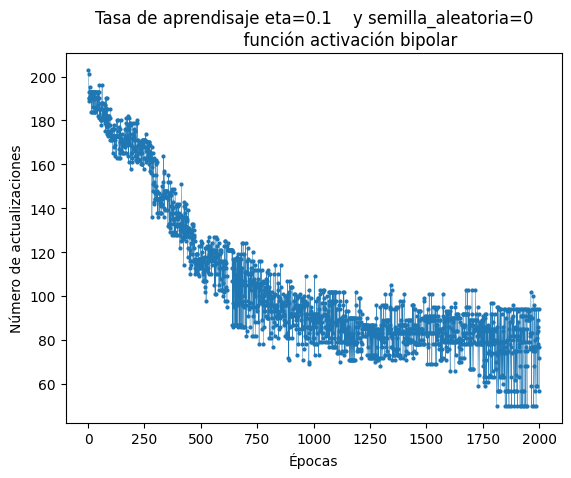

In [37]:
plot_errors(perceptrones_bipolares[0])
plt.show()

Vemos que las grafica correctamente, pero queremos un suplots para comparar para diferentes semillas aleatoria pare eso creamos la siguiente función 

In [38]:
def plot_errors_comparados(modelo_perceptron, ax):
    if modelo_perceptron.funcion=="bipolar":
        color = "blue"
    else:
        color = "red"
    ax.plot(range(1, len(modelo_perceptron.errors_) + 1), modelo_perceptron.errors_,color=color,linewidth=0.3,
           marker='o', markersize=0.5)
    ax.set_xlabel('Épocas',fontsize=6)
    ax.set_ylabel('Número de actualizaciones',fontsize=6)
    ax.set_title(f"Tasa de aprendizaje eta={modelo_perceptron.eta}"\
                 f"y semilla_aleatoria={modelo_perceptron.random_state}\n"
                 f"Función activación={modelo_perceptron.funcion}",fontsize=6)


Ya creada la función podemos graficas para comparar pero solo variando la tasa de aprendisaje y la semilla

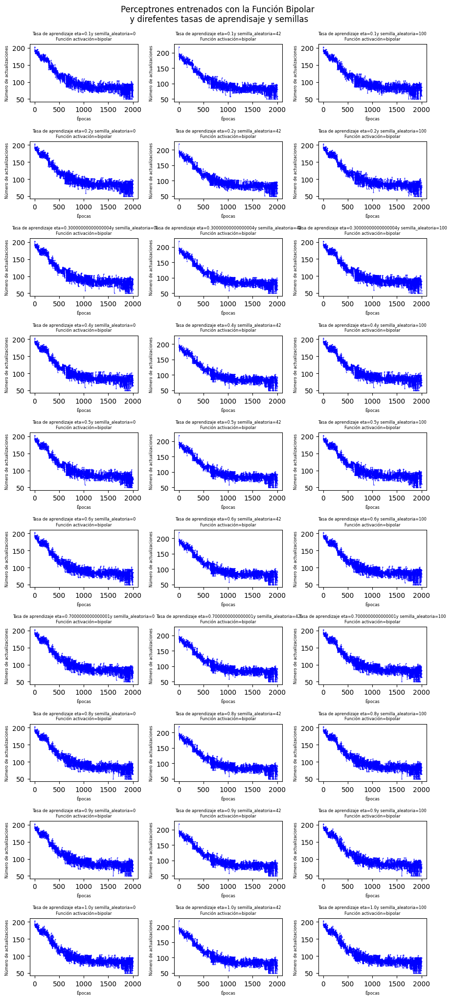

In [39]:
fig, axes = plt.subplots(10, 3, figsize=(9, 20))
axes=axes.ravel()
for i, ax in enumerate(axes):
    
    plot_errors_comparados(perceptrones_bipolares[i], ax)

plt.tight_layout()
plt.suptitle("Perceptrones entrenados con la Función Bipolar\n y direfentes tasas de aprendisaje y semillas",x=0.5,y=1.02)
plt.show()


Vemos que en general son muy similares los errores para la función de acivación bipolar para distintas tasas de aprendisaje y distintas semillas aleatorias  

Ahora lo mismo para la función de activacion unipolar 

In [40]:
inicio = time.time()


etas = np.arange(0.1, 1 + 0.1, 0.1)
semillas = [0,42,100]
funciones = ["unipolar"]
targets = [y_unipolar]
iteraciones = 2000
perceptrones_unipolares = []


inicio = time.time()
# Define una función para el bucle interno que será paralelizado
def entrenar_modelo(eta, semilla, funcion, targ, X_par_selec):
    modelo = Perceptron(eta, iteraciones, semilla, funcion)
    modelo.fit(X_par_selec, targ)
    return modelo

# Define tus variables aquí

# Paraleliza el bucle interno
perceptrones_unipolares = Parallel(n_jobs=-1)(delayed(entrenar_modelo)(eta, semilla, funcion, targ, X_par_selec)
                                   for eta in etas
                                   for semilla in semillas
                                   for funcion, targ in zip(funciones, targets))

# Obtener el tiempo de finalización
fin = time.time()

# Calcular el tiempo de ejecución
tiempo_ejecucion = fin - inicio
print(f"Tiempo de ejecución: {tiempo_ejecucion:.2f} segundos")
print(f"Total de perceptrones entrenados {len(perceptrones_unipolares)} con {iteraciones} iteraciones cada uno")

Tiempo de ejecución: 43.73 segundos
Total de perceptrones entrenados 30 con 2000 iteraciones cada uno


Ahora la grafica del error para perceptrones unipolares 

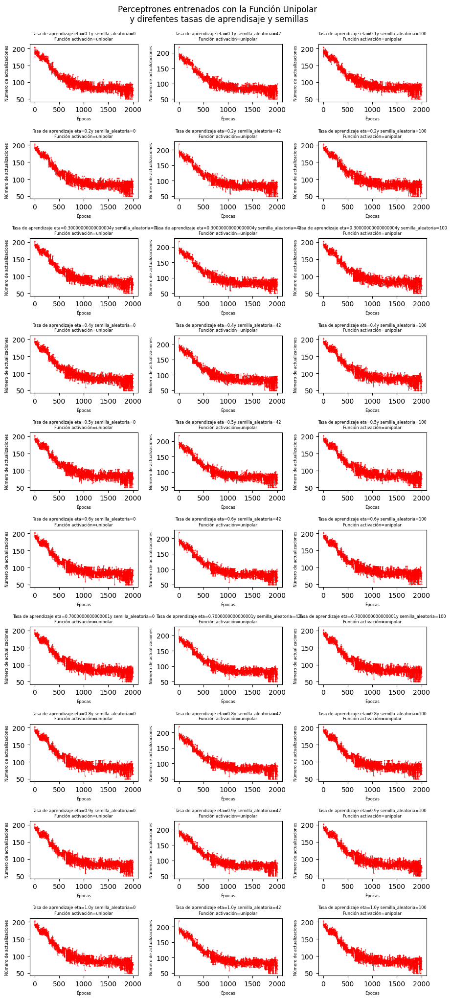

In [41]:
fig, axes = plt.subplots(10, 3, figsize=(9, 20))
axes=axes.ravel()
for i, ax in enumerate(axes):
    
    plot_errors_comparados(perceptrones_unipolares[i], ax)

plt.tight_layout()
plt.suptitle("Perceptrones entrenados con la Función Unipolar\n y direfentes tasas de aprendisaje y semillas",x=0.5,y=1.02)
plt.show()

Grafiquermos el error de cada perceptron para un semilla dada y una tasa de aprendisaje dada

De las graficas anteriores no se ve una diferencia marcada de la elección de la tasa de aprendisaje, la semilla aleatoria ni de la función de activación utilizada, por tanto, para decidir cual es el mejor modelo debemos definir una metrica. 


Con este fin, definimos la siguinte metrica.

Dado que los pacientes que mayor importancia tiene disnosticar es aquellos con tumor maligno, tomamos las 10 epocas con menor error en cada entrenamiento y calculamos el error de las clase tumor maligno :1, para estos pesos y sesgos, finalmente el mejor modelo sera el que tenga menos error en clasificar la clase 1 tumor maligno.



In [42]:
import copy # para copiar objetos 

def metrica(modelo_entrenado,X,y):
    # copiamos el modelo en otra variable
    copia_modelo = copy.deepcopy(modelo_entrenado)
    
    
    # lista de errores
    errores = modelo_entrenado.errors_
    # ordena los errores y retorna sus 10 primeros indices 
    indices_errores_ordenados = np.argsort(errores)[:10] 
    # lista de pesos entrenados
    
    #print(indices_errores_ordenados)
    
    
    pesos_historicos = np.array(copia_modelo.w_historical[1:])
    
    
    # escojemos los pesos con los indices de error minimo
    pesos_error_minimo = pesos_historicos[indices_errores_ordenados]
    
    
    copia_modelo.w_ = pesos_error_minimo[1]
    

    
    
    
    # selelccionemos las etiquetas de tumor maligno y las caracteristicas
    y_maligno = y[y==1]
    X_maligno = X[y==1]
    #print(len(y_maligno))
    #print(len(X_maligno))
    
    # Ahora colocamos cada conjunto de pesos y calculamos su error para cada conjunto sobre etiqueta_maligno  
    
    error_final_maligno = 10**5
    pesos_finales =[]
    for pesos in pesos_error_minimo:
        # asignamos sus nuevos pesos 
        copia_modelo.w_ = pesos  
        # predecimos los valores de y maligno
        y_pred_maligno = copia_modelo.predict(X_maligno)
        
        # ahora calculamos su error 
        error_maligno = ((y_maligno-y_pred_maligno)!=0).sum()
        
        
        # guarda pesos y error maligmo minimo
        if error_final_maligno>error_maligno:
            
            error_final_maligno = error_maligno
            pesos_finales = pesos
            #print(error_final_maligno)
    # asigna los pesos optimos de tal manera que error maligno sea minimo
    
    copia_modelo.w_= pesos_finales
    # retorna los pesos finales y el error maligno 
    return  copia_modelo   
    


Ya habiendo definido la metrica podemos probarla hay que tener en cuenta que la metrica devuelve el modelo con el mejor conjunto de pesos y sesgos, que clasifican de manera correcta y el error de clasificación en tumor maligo clase 1.  

vamos a aplicar la metrica y graficar la calsificacón antes y despues probemos con un solo modelo bipolar, pare sto generamos la siguinte función que grafica   

In [43]:
def grafico_perceptron(X,y,modelo):
    
    plt.figure()
    #clases
    clases = np.unique(y)
    
    #valores maximo y minimo para x,y
    x_max,y_max = X.max(axis=0)+20
    x_min,y_min = X.min(axis=0)-20
    
    # grafico de dispersión
    sns.scatterplot(x= X[:,0],y=X[:,1],
               hue=y,palette=['red', 'blue'],
                style=y,markers=['d', 's'], 
                alpha=0.7)
    
    #obtengo los pesos del modelo
    pesos = modelo.w_
    
    w1 = pesos[1]
    w2 = pesos[2]
    b = pesos[0]
  
    x_line =  np.linspace(50, 250, 100)
    y_line = -w1/w2*x_line-b/w2
    plt.plot(x_line,y_line,linestyle='-.',color='black',
                   label='Frontera entre clases')
    
    
    # grilla de diferencia de clases
    x_grid = np.linspace(x_min,x_max , 100)
    y_grid = np.linspace(y_min,y_max , 100)
    xx, yy = np.meshgrid(x_grid, y_grid)
    
     #crea la region de cada clase
    puntos_grilla = np.c_[xx.ravel(), yy.ravel()]
    predict_grilla=modelo.predict(puntos_grilla)
    contour = plt.contourf(xx, yy, predict_grilla.reshape(xx.shape),
               cmap=plt.cm.bwr.reversed(), alpha=0.15)
    
    #limites del grafico
    plt.xlim(x_min,x_max)
    plt.ylim(y_min,y_max)
    
    artistas, etiquetas = plt.gca().get_legend_handles_labels()
    plt.legend(handles=artistas, labels=[f'Benigno:{clases[0]}'
                      ,f'Maligno : 1','Frontera entre clases'])
    plt.xlabel('worst perimeter')
    plt.ylabel('worst texture')
    
    plt.title(f"Modelo del perceptron entrenado con los pesos w1={w1:.2f}, w2={w2:.2f} y b={b:.2f}")
    return plt.gcf()  # Retorna la figura actual
    
    
    

Graficamos un modelo antes de aplicar la metrica

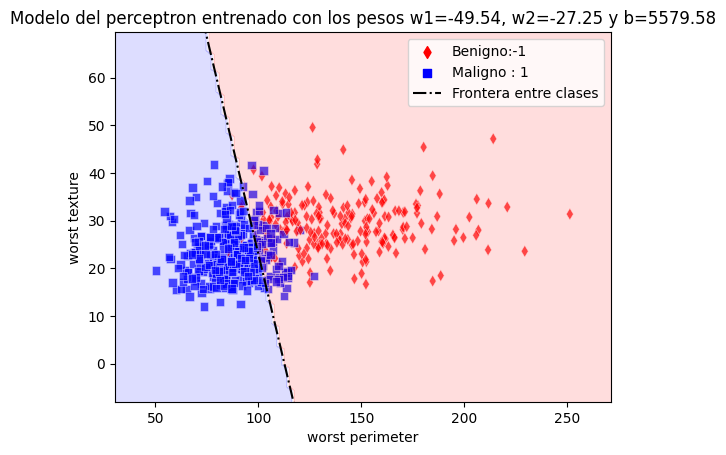

In [44]:
modelo_bipolar = perceptrones_bipolares[2]
# modelo antes de aplicar la metrica
grafico_perceptron(X_par_selec,y_bipolar,modelo_bipolar)
plt.show()


Ahora aplicamos la metrica y graficamos con  los mejores pesos para clasificar la clase maigno 1.

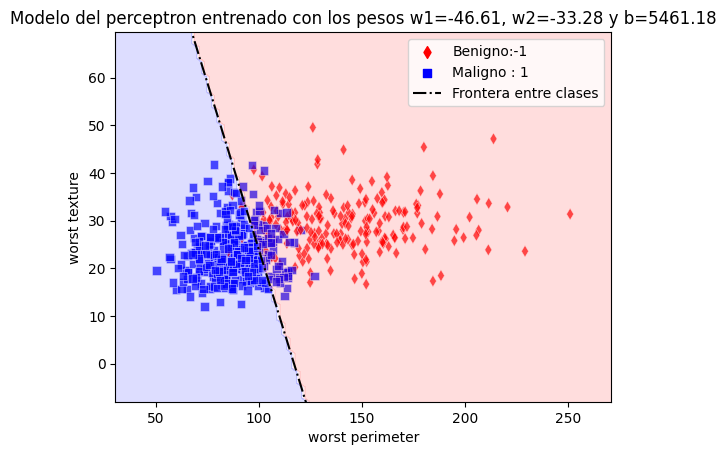

In [45]:
modelo_optimo = metrica(modelo_bipolar,X_par_selec,y_bipolar)
grafico_perceptron(X_par_selec,y_bipolar,modelo_optimo)
plt.show()

Como vemos en la grafica la diferencia entre los modelos no es perceptible, por tanto, crearemos una función que devuelva el error maligno y el error total

In [46]:
def errores(modelo_entrenado_,X,y):
    y_predicha = modelo_entrenado_.predict(X) 
    
    error_total = ((y_predicha-y)!=0).sum()
    
    y_maligno = y[y==1]
    y_predicha_maligno = modelo_entrenado_.predict(X[y==1])
    
    error_maligno = ((y_predicha_maligno-y_maligno)!=0).sum()
    
    return error_maligno, error_total 
    
    

Apliquemosla a los modelos anteriores 

In [47]:
errores(modelo_bipolar,X_par_selec,y_bipolar)

(67, 73)

In [48]:
errores(modelo_optimo,X_par_selec,y_bipolar)

(59, 65)

Vemos que el error al clasificar la clase 1 maligno: pasa de 122 a 118, po tanto, al aplicar la función metrica escoje el mejor modelo que clasifica la calse 1 maligno.

Ya habiendo definido una matrica podemos aplicarlos a todos los perceptrones entrenado para escojer el mejor.



In [49]:
modelo_optimos_bipolares = []
for indice,modelo in enumerate(perceptrones_bipolares):
    modelo_optimo_ = metrica(modelo,X_par_selec,y_bipolar)
    error = errores(modelo_optimo_,X_par_selec,y_bipolar)
    
    modelo_optimos_bipolares.append([f"indice={indice}",modelo_optimo_,error])
    
modelo_optimos_bipolares   

[['indice=0', <__main__.Perceptron at 0x1963b147b20>, (59, 65)],
 ['indice=1', <__main__.Perceptron at 0x1961c570130>, (59, 65)],
 ['indice=2', <__main__.Perceptron at 0x1963b1462c0>, (59, 65)],
 ['indice=3', <__main__.Perceptron at 0x1963b145840>, (59, 65)],
 ['indice=4', <__main__.Perceptron at 0x1963b1467a0>, (59, 65)],
 ['indice=5', <__main__.Perceptron at 0x1963b145240>, (58, 64)],
 ['indice=6', <__main__.Perceptron at 0x1963b146500>, (59, 65)],
 ['indice=7', <__main__.Perceptron at 0x1963b144be0>, (59, 65)],
 ['indice=8', <__main__.Perceptron at 0x1963b144a60>, (59, 65)],
 ['indice=9', <__main__.Perceptron at 0x1963b1479d0>, (59, 65)],
 ['indice=10', <__main__.Perceptron at 0x1963b146200>, (59, 65)],
 ['indice=11', <__main__.Perceptron at 0x1963b147790>, (59, 65)],
 ['indice=12', <__main__.Perceptron at 0x1963b146170>, (59, 65)],
 ['indice=13', <__main__.Perceptron at 0x1963b145c30>, (59, 65)],
 ['indice=14', <__main__.Perceptron at 0x1963b145f30>, (59, 65)],
 ['indice=15', <__ma

Vemos que el mejor modelo tiene 58 errores en la clase maligno y 64 errores totales, cuyo indice es 5.
Obtengamos ese modelo, sus caracteriticas y sus graficas




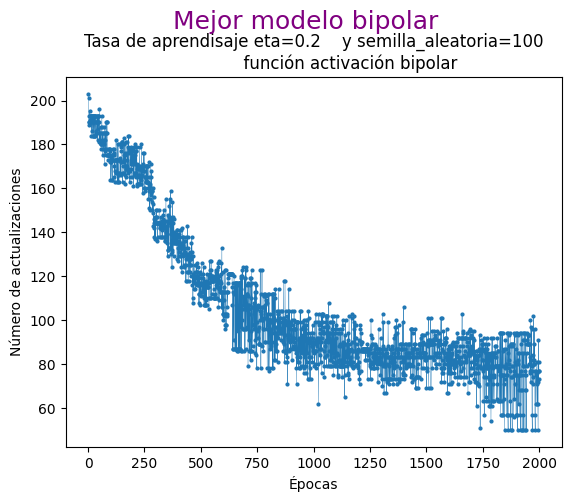

In [50]:
mejor_modelo_bipolar = modelo_optimos_bipolares[5][1] 
plot_errors(mejor_modelo_bipolar)

plt.suptitle("Mejor modelo bipolar",fontsize = 18,color= "purple",x=0.5,y=1.02)
plt.show()

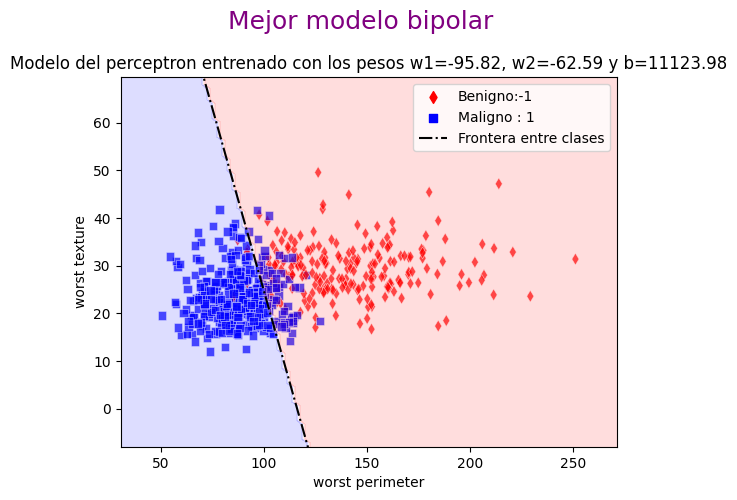

In [51]:
modelo_optimo = metrica(mejor_modelo_bipolar,X_par_selec,y_bipolar)
grafico_perceptron(X_par_selec,y_bipolar,modelo_optimo)
plt.suptitle("Mejor modelo bipolar",fontsize = 18,
             color= "purple",x=0.5,y=1.02)
plt.show()

Ahora podemos hacer lo mismo para el mejor modelo unipolar

In [52]:
modelo_optimos_unipolares = []
for indice,modelo in enumerate(perceptrones_unipolares):
    modelo_optimo_ = metrica(modelo,X_par_selec,y_unipolar)
    error = errores(modelo_optimo_,X_par_selec,y_unipolar)
    
    modelo_optimos_unipolares.append([f"indice={indice}"
                                      ,modelo_optimo_,error])
    
modelo_optimos_unipolares   

[['indice=0', <__main__.Perceptron at 0x1960a24d9c0>, (59, 65)],
 ['indice=1', <__main__.Perceptron at 0x1960a14f820>, (59, 65)],
 ['indice=2', <__main__.Perceptron at 0x1960a24ed70>, (59, 65)],
 ['indice=3', <__main__.Perceptron at 0x1960a24d7b0>, (59, 65)],
 ['indice=4', <__main__.Perceptron at 0x1960a24dba0>, (59, 65)],
 ['indice=5', <__main__.Perceptron at 0x1960a24e2c0>, (59, 65)],
 ['indice=6', <__main__.Perceptron at 0x1960a24da20>, (59, 65)],
 ['indice=7', <__main__.Perceptron at 0x1960a24d720>, (59, 65)],
 ['indice=8', <__main__.Perceptron at 0x1960a24d4e0>, (59, 65)],
 ['indice=9', <__main__.Perceptron at 0x1960a24f610>, (59, 65)],
 ['indice=10', <__main__.Perceptron at 0x1960a24cdc0>, (59, 65)],
 ['indice=11', <__main__.Perceptron at 0x1960a24e830>, (58, 64)],
 ['indice=12', <__main__.Perceptron at 0x1960a24e1d0>, (59, 65)],
 ['indice=13', <__main__.Perceptron at 0x1960a24d8d0>, (59, 65)],
 ['indice=14', <__main__.Perceptron at 0x1960a24fa60>, (59, 65)],
 ['indice=15', <__ma

De la salida anterior vemos que estos modelos unipolares clasifican basicamente igual que utilizando la función de activación bipolar, siendo, el indice 11 con el mejor modelo un error total de 64 y 58 en la clase tumor maligno, de esto podemos decir que el comportamiento con cualquier función es basicam,ente la misma. 



Veamos sus graficos 

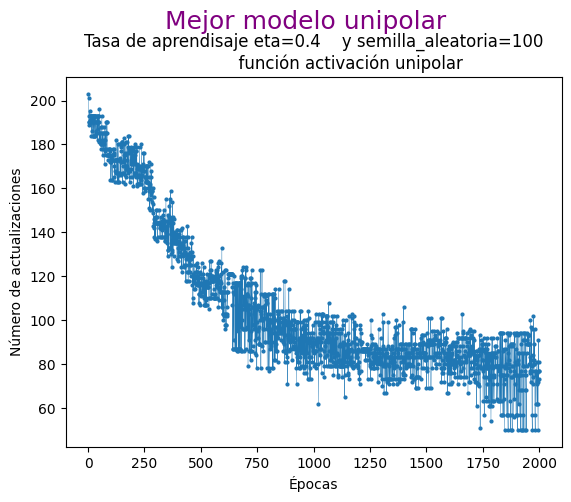

In [79]:
mejor_modelo_unipolar = modelo_optimos_unipolares[11][1] 
plot_errors(mejor_modelo_unipolar)

plt.suptitle("Mejor modelo unipolar",fontsize = 18,color= "purple",x=0.5,y=1.02)
plt.show()

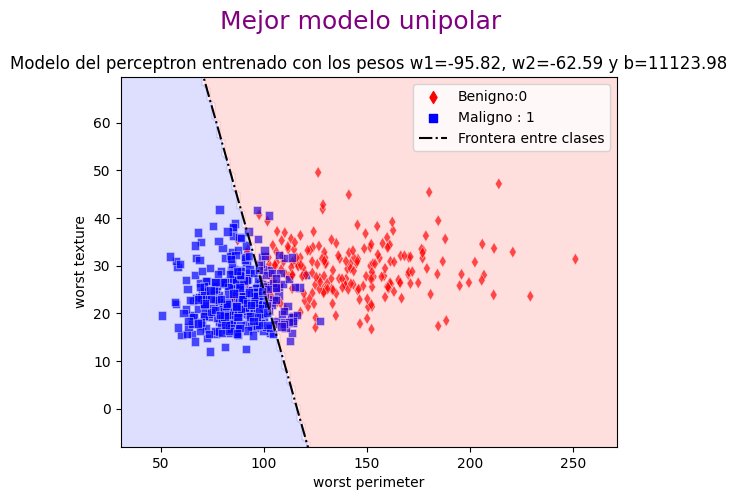

In [54]:
modelo_optimo = metrica(mejor_modelo_unipolar,X_par_selec,y_unipolar)
grafico_perceptron(X_par_selec,y_unipolar,modelo_optimo)
plt.suptitle("Mejor modelo unipolar",fontsize = 18,color= "purple",x=0.5,y=1.02)
plt.show()

Como era de esperar los dos mejores modelos con función bipolar o unipolar, tienen el mismo error.

# Conclusión punto 4:
* Se concluye quer sim importar la función activación se llega al mismo valor de clasificación correcta.
* si hay una ligera dependencia de la tasa de aprendisaje y de la semilla aleatoria, téngase en cuenta que solo se tomo un modelo optimo pero puede haber mas de uno para ambas funciónes de activación, que tenga diferentes semillas y tasas de aprendisaje.  

5. Cree y entrene un modelo tipo Adaline con los datos anteriormente
presentados, repita, si considera necesario el ejercicio realizando las
variaciones en el coeficiente de aprendizaje para al final usar el que considere
fue el mejor entrenamiento logrado.

Para este punto se usa la clase AdalineGD

In [55]:
class AdalineGD(object):
    """ADAptive LInear NEuron classifier.

    Parámetros
    ------------
    |eta : float
      Tasa de aprendizaje (entre 0.0 y 1.0)
    |n_iter : int
      Número de iteraciones sobre el dataset.
    |random_state : int
      Semilla del generador de números aleatorios para la inicialización del bias y pesos aleatorios.


    Atributos
    -----------
    |w_ : Arreglo 1D
      Pesos antes del entrenamiento (Iniciales).
    |cost_  : list
      Valro de la función de costo de suma de cuadrados en cada época.


    """
    #FUNCIÓN PARA INICIALIZAR MI ADALINE
    def __init__(self, eta=0.01, n_iter=50, random_state=1):
        self.eta = eta
        self.n_iter = n_iter
        self.random_state = random_state

    def fit(self, X, y):
        """ Datos de entrenamiento para ajustar.

          Parameters
        ----------
        X : {Tipo matriz}, Dimensión = [n_muestras, n_características]
          Training vectors, donde n_muestras es el número de muestras y
          n_características es el número de características.
        y : Tipo vector fila, shape = [n_samples]
          Target values.

        Returns
        -------
        self : object

        """
        rgen = np.random.RandomState(self.random_state)


        self.w_ = rgen.normal(loc=0.0, scale=0.01, size=1 + X.shape[1])
        self.cost_ = []

        for i in range(self.n_iter):

            #Se calcula la NETA para todos los valores de entrada
            net_input = self.net_input(X)

            #Observe por favor que a continuación se llama a la función de activación
            #Pero en realidad no tiene efecto, se podría colocar directamente:
            #output = self.net_input(X)
            #Pero el propósito es dejar dispuesto el código para usar la función de activación en otros casos.
            output = self.activation(net_input)

            errors = (y - output)

            self.w_[1:] += self.eta * X.T.dot(errors)

            self.w_[0] += self.eta * errors.sum()

            cost = (errors**2).sum() / 2.0
            self.cost_.append(cost)
        return self

    def net_input(self, X):
        """Calcula el valor neto (Z)"""
        return np.dot(X, self.w_[1:]) + self.w_[0]

    def activation(self, X):
        """Función de activación lineal"""
        return X

    def predict(self, X):
        """Retonar el valor de clase perteneciente"""
        return np.where(self.activation(self.net_input(X)) >= 0.0, 1, -1)

Observando la calse AdalineGD se tiene en cuenta que utiliza para el predict la funcón bipolar, por tanto, se debe utilizar la etiqueta y_bipolar para los datos objetivos.  

Comencemos creando un modelo AdalineGD.

In [56]:
modelo_ada =  AdalineGD(eta=0.001, n_iter=200, random_state=1)
modelo_ada.fit(X_par_selec,y_bipolar)


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_8416\3802733282.py:68: RuntimeWarning: overflow encountered in square
  cost = (errors**2).sum() / 2.0
C:\Users\USUARIO\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
C:\Users\USUARIO\AppData\Local\Temp\ipykernel_8416\3802733282.py:64: RuntimeWarning: invalid value encountered in add
  self.w_[1:] += self.eta * X.T.dot(errors)
C:\Users\USUARIO\AppData\Local\Temp\ipykernel_8416\3802733282.py:66: RuntimeWarning: invalid value encountered in double_scalars
  self.w_[0] += self.eta * errors.sum()


Como vemos en la salida anterior se esta debordando el calculo del error esto se debe principalmente a que los datos no estas normalizados, por tanto, debemos normalizarlos, por ejemplo observemos su media y su desviación standar


In [57]:
print(f"Medias {X_par_selec.mean(axis=0)}")
print(f"desviación standar {X_par_selec.std(axis=0)}")

Medias [107.26121265  25.6772232 ]
desviación standar [33.57300157  6.14085432]


Claramente los valores no se encuentran normalizados, vamos a normalizarlos utilizando la formula  
$$
xn_i =\frac{x_i-\overline{x}}{\sigma}
$$

Listo ya teniendo los valores y la formula standarizamos los datos

In [58]:
x0_n= (X_par_selec[:,0]-X_par_selec[:,0].mean())/X_par_selec[:,0].std()
x1_n= (X_par_selec[:,1]-X_par_selec[:,1].mean())/X_par_selec[:,1].std()
X_par_selec_normalizadas = np.column_stack([x0_n,x1_n]) 
X_par_selec_normalizadas

array([[ 2.30360062, -1.35929347],
       [ 1.53512599, -0.36920322],
       [ 1.34747521, -0.02397438],
       ...,
       [ 0.57900058,  1.37485378],
       [ 2.30360062,  2.23792588],
       [-1.43273495,  0.76418957]])

In [59]:
print(f"Medias {X_par_selec_normalizadas.mean(axis=0)}")
print(f"desviación standar {X_par_selec_normalizadas.std(axis=0)}")

Medias [-4.01553424e-16 -1.83411185e-17]
desviación standar [1. 1.]


Vemos que las medias son cercanas a 0 y la desvión standar 1.

Ahora usemos las caracteristicas normalizadas para entrenar el AdalineGD(), pero primero generemos unsa grafica.

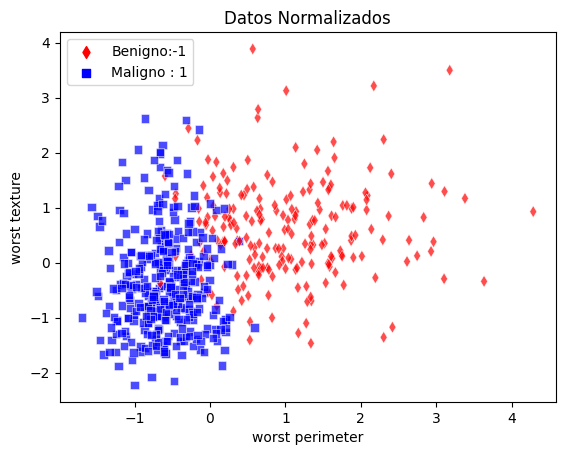

In [60]:
clases=np.unique(y_bipolar)
sns.scatterplot(x=X_par_selec_normalizadas[:,0],y=X_par_selec_normalizadas[:,1],
                hue=y_bipolar,palette=['red', 'blue'],
                style=y_bipolar,markers=['d', 's'], 
                alpha=0.7)
plt.xlabel('worst perimeter')
plt.ylabel('worst texture')
artistas, etiquetas = plt.gca().get_legend_handles_labels()
plt.legend(handles=artistas, labels=[f'Benigno:{clases[0]}'
                      ,f'Maligno : 1'])
plt.title("Datos Normalizados")
plt.show()

Ya habiendo normalizado los datos entrenamos el modelo AdalineGD()

In [61]:
modelo_ada = AdalineGD(eta=0.001, n_iter=2000, random_state=1)
modelo_ada.fit(X_par_selec_normalizadas,y_bipolar)

Como vemos ya no diverge, grafiquemos su error  

Text(0, 0.5, 'J(w) SSE')

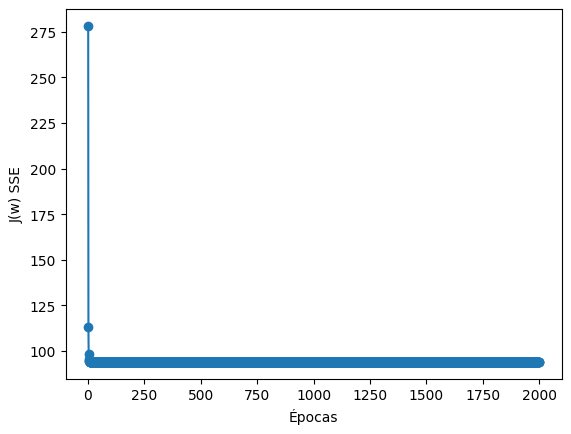

In [62]:
plt.plot(range(1, len(modelo_ada.cost_) + 1), modelo_ada.cost_, 
         marker='o')
plt.xlabel('Épocas')
plt.ylabel('J(w) SSE')

Vemos que rapidamente disminuye su error cuadratico medio.

Ahora grafiquemos las regiones, para esto usamos la función  

In [63]:
def grafico_adaline(X,y,modelo):
    
    plt.figure()
    #clases
    clases = np.unique(y)
    
    #valores maximo y minimo para x,y
    x_max,y_max = X.max(axis=0)+1
    x_min,y_min = X.min(axis=0)-1
    
    
    pesos = modelo.w_
    
    w1 = pesos[1]
    w2 = pesos[2]
    b = pesos[0]
    
    
    # grafico de dispersión
    sns.scatterplot(x= X[:,0],y=X[:,1],
               hue=y,palette=['red', 'blue'],
                style=y,markers=['d', 's'], 
                alpha=0.7)
    
    # grilla de diferencia de clases
    x_grid = np.linspace(x_min,x_max , 400)
    y_grid = np.linspace(y_min,y_max , 400)
    xx, yy = np.meshgrid(x_grid, y_grid)
    
     #crea la region de cada clase
    puntos_grilla = np.c_[xx.ravel(), yy.ravel()]
    predict_grilla=modelo.predict(puntos_grilla)
    contour = plt.contourf(xx, yy, predict_grilla.reshape(xx.shape),
               cmap=plt.cm.bwr.reversed(), alpha=0.15)
    
    #limites del grafico
    plt.xlim(x_min,x_max)
    plt.ylim(y_min,y_max)
    
    artistas, etiquetas = plt.gca().get_legend_handles_labels()
    plt.legend(handles=artistas, labels=[f'Benigno:{clases[0]}'
                      ,f'Maligno : 1'])
    plt.xlabel('worst perimeter')
    plt.ylabel('worst texture')
    
    plt.title(f"Modelo Adaline entrenado con los pesos\
    w1={w1:.3f}, w2={w2:.3f} y b={b:.3f}")
    return plt.gcf()  # Retorna la figura actual
    
    

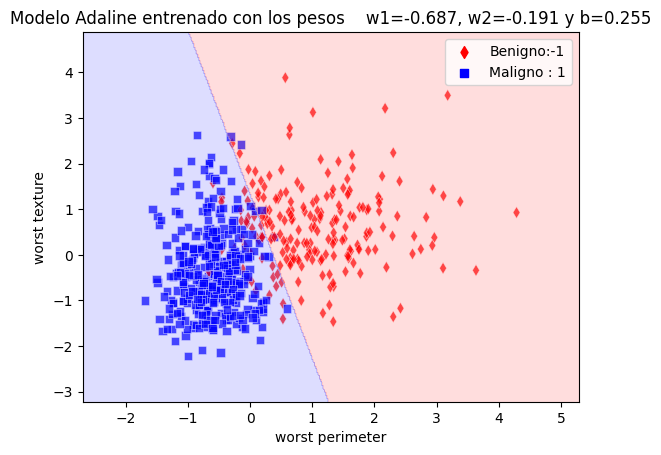

In [64]:
grafico_adaline(X_par_selec_normalizadas, y_bipolar, modelo_ada)
plt.show()

Ya habiendo probado un modelo podemos entrenar varios para distintas tasas de aprendisaje y distantas semillas

In [65]:
etas_adaline = np.array([0.0001,0.001,0.003,0.01,0.03,0.1,0.3,0.8])
semillas_adaline = [0,1,2,3,4,42,100,1000]
iteraciones_adaline = 100
modelos_adaline=[]

for eta in etas_adaline:
    for semilla in semillas_adaline:
        modelo_adaline = AdalineGD(eta=eta, n_iter=iteraciones_adaline, random_state=semilla)
        modelo_adaline.fit(X_par_selec_normalizadas,y_bipolar)
        modelos_adaline.append(modelo_adaline)
          
print(f"Modelos Adaline entrenados {len(modelos_adaline)}")

Modelos Adaline entrenados 64


C:\Users\USUARIO\AppData\Local\Temp\ipykernel_8416\3802733282.py:68: RuntimeWarning: overflow encountered in square
  cost = (errors**2).sum() / 2.0
C:\Users\USUARIO\AppData\Local\Programs\Python\Python310\lib\site-packages\numpy\core\_methods.py:48: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)


Ya habiendo entrenado los modelos podemos graficar su error, para comparar para esto usamos la función plot_errors_comparados_adaline

In [66]:
def plot_errors_comparados_adaline(modelo_adaline, ax):
    
    ax.plot(range(1, len(modelo_adaline.cost_) + 1), modelo_adaline.cost_,linewidth=0.9,
           marker='o', markersize=0.9)
    ax.set_xlabel('Épocas',fontsize=15)
    ax.set_ylabel('J(w) SSE',fontsize=15)
    ax.set_title(f"Tasa de aprendizaje eta={modelo_adaline.eta}\
    y semilla_aleatoria={modelo_adaline.random_state}",fontsize=18)
    cv=""
    if np.isnan(modelo_adaline.cost_[-1]):
        cv="Diverge"
    elif modelo_adaline.cost_[-1]>=100:
        cv="Diverge"
    else:
        cv="Converge"
    
    ax.text(60,modelo_adaline.cost_[-1], f"{cv}", fontsize=20,color="red")
   
    
    
    

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

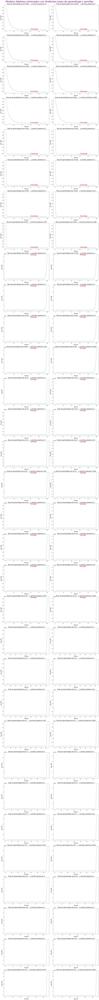

In [67]:
fig, axes = plt.subplots(32, 2, figsize=(18, 180))
axes=axes.ravel()
for i, ax in enumerate(axes):
    
    plot_errors_comparados_adaline(modelos_adaline[i], ax)

plt.tight_layout()
plt.suptitle("Modelos Adalines entrenados con direfentes tasas de aprendisaje y semillas",x=0.5,y=1.002,
            fontsize=30, color="purple")
plt.show()

Vemos en la salida anterior que para una semillas y una tasa de aprendisaje los modelos divergen, dando valores de SSE extremadamente altos

Ahora definamos una especie de metrica para escojer el mejor modelo, primero filtremos los modelos cuyo valor de SSE sea menor a 100, esto es para eliminar los modelos que divergen

In [68]:
def filtro(modelos_):
    modelos_finales_ada = []
    for modelo_ in modelos_:
        if modelo_.cost_[-1]<=100:
            modelos_finales_ada.append(modelo_)
    return modelos_finales_ada

Aplicamos el filtro 

In [69]:
modelos_finales_adaline = filtro(modelos_adaline)
print(f"Número de modelos finales {len(modelos_finales_adaline)}")

Número de modelos finales 16


Vemos que el numero de modelos que convergen son 64, ahora definamos una metrica de evaluación de estos modelos sobre la calse 1 maligno, para escojer que que mejor la clasifique

In [70]:
def errores_adaline(modelos_adaline_entrenados,X,y):
    errores_totales_adaline=[]
    for indi, modelos_ada_f in enumerate(modelos_adaline_entrenados):
        
        y_predicha = modelos_ada_f.predict(X)
        error = ((y-y_predicha)!=0).sum()
        y_maligno = y[y==1]
        X_maligno = X[y==1]
        y_predicha_maligno = modelos_ada_f.predict(X_maligno)
        error_maligno = ((y_maligno-y_predicha_maligno)!=0).sum()
        errores_totales_adaline.append([indi,error,error_maligno])
    return errores_totales_adaline

In [71]:
print("indice,error,error_maligno")
errores_adaline(modelos_finales_adaline,X_par_selec_normalizadas,
                y_bipolar)

indice,error,error_maligno


[[0, 44, 4],
 [1, 44, 4],
 [2, 44, 4],
 [3, 44, 4],
 [4, 44, 4],
 [5, 44, 4],
 [6, 44, 4],
 [7, 44, 4],
 [8, 44, 4],
 [9, 44, 4],
 [10, 44, 4],
 [11, 44, 4],
 [12, 44, 4],
 [13, 44, 4],
 [14, 44, 4],
 [15, 44, 4]]

Como vemos anteriormente todos  todo tienen el mismo error de clasificación en las calses siendo 4, en la calse 1 maligno

Grafiquemos sus errores y su area de calsificación

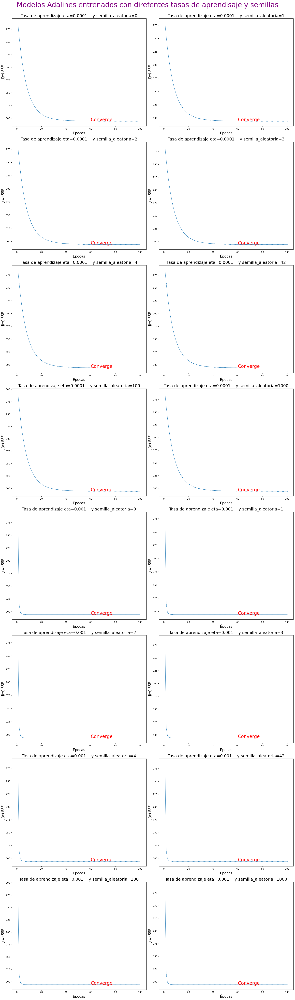

In [72]:
fig, axes = plt.subplots(8, 2, figsize=(18, 60))
axes=axes.ravel()
for i, ax in enumerate(axes):
    
    plot_errors_comparados_adaline(modelos_finales_adaline[i], ax)

plt.tight_layout()
plt.suptitle("Modelos Adalines entrenados con direfentes \
tasas de aprendisaje y semillas",x=0.5,y=1.01,
            fontsize=30, color="purple")
plt.show()

Como se puede observar la tasa de aprendisaje para que converga es 0.0001 y 0.001, la cual es pequeña.

Ahora grafiquemos los modelos 

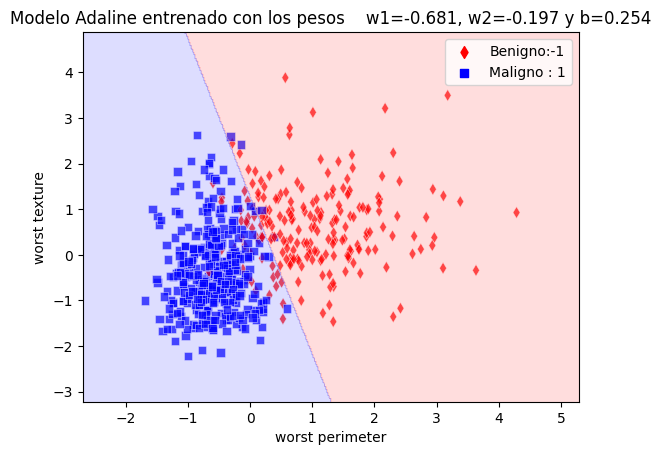

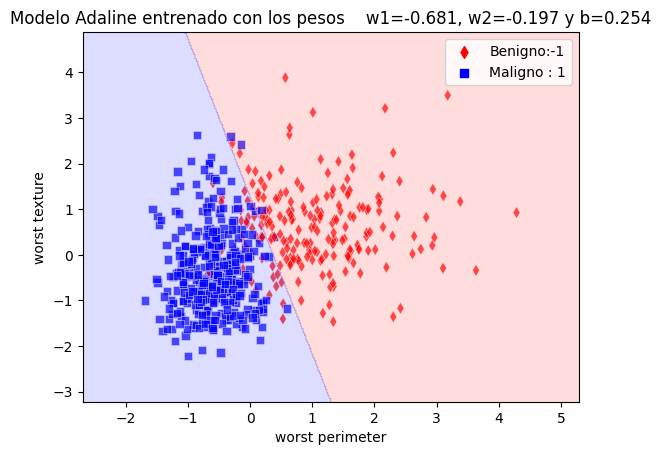

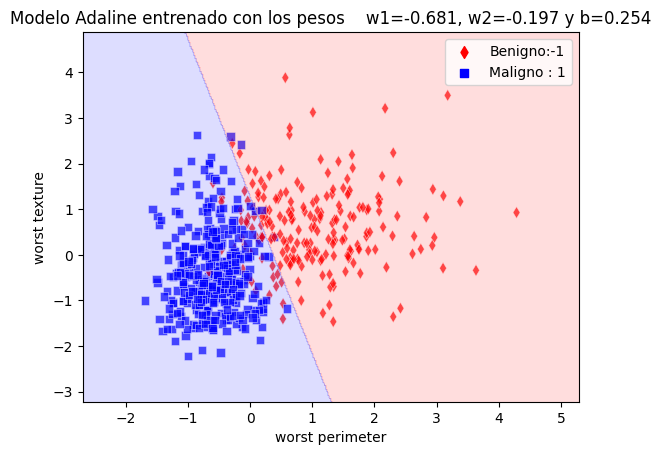

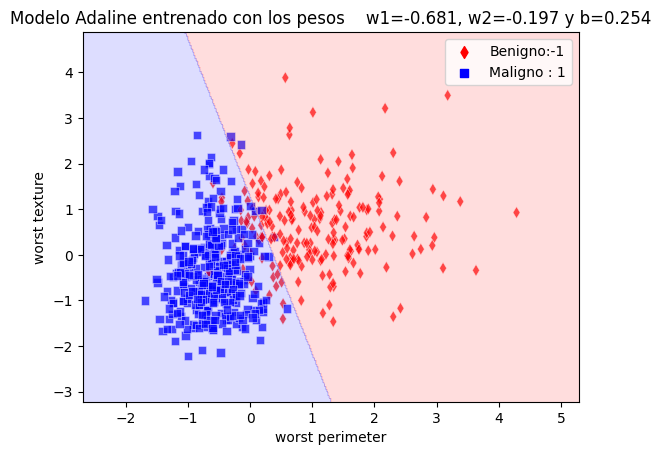

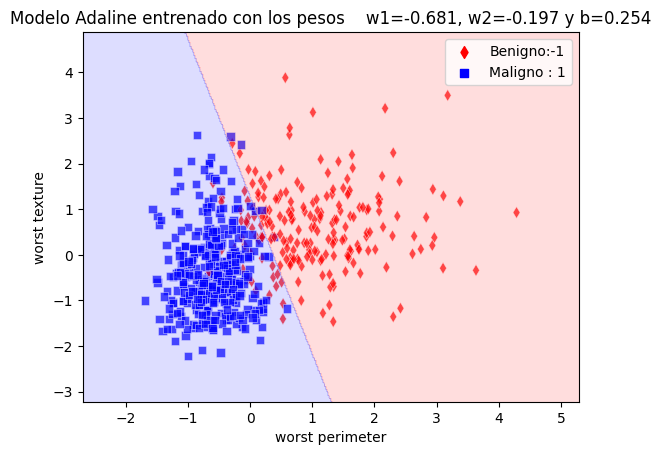

...

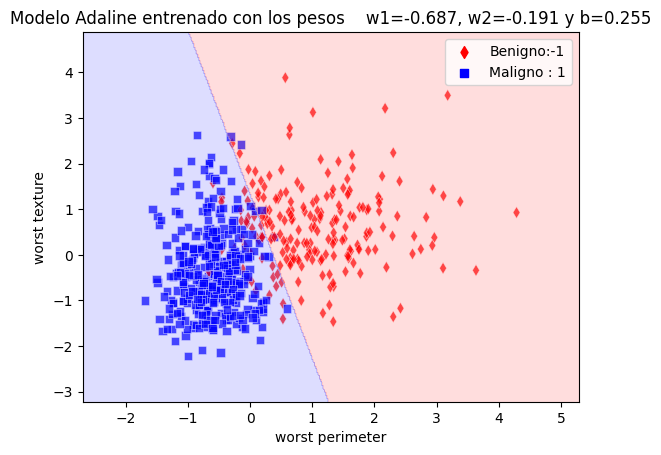

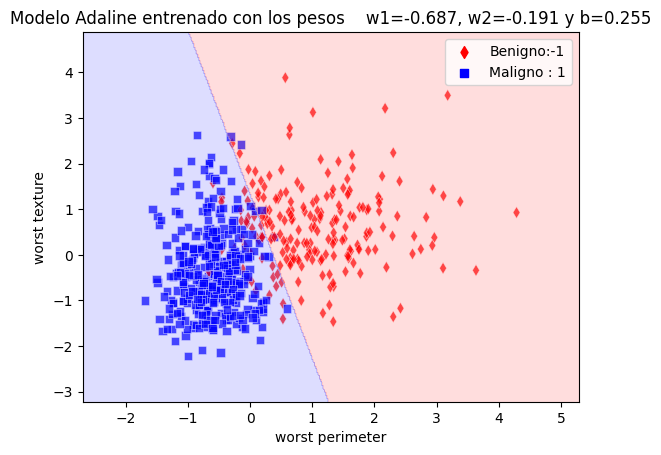

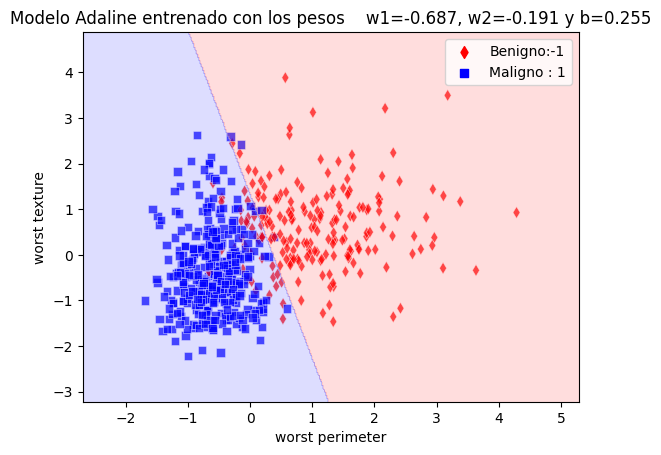

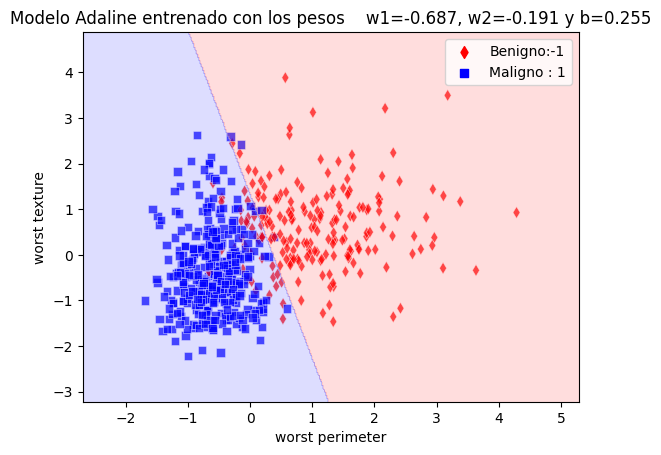

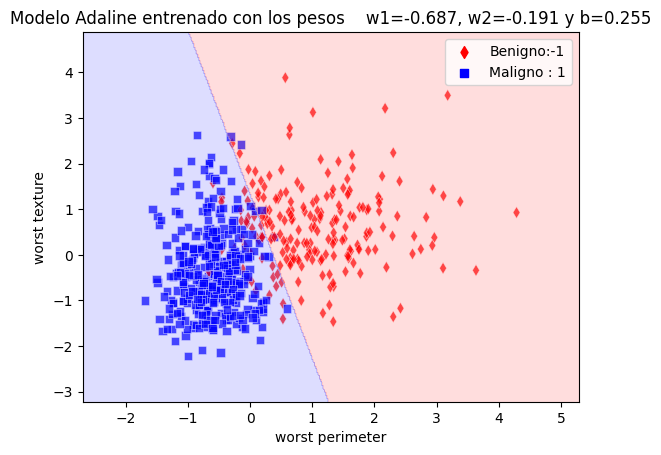

In [73]:
for modelo in modelos_finales_adaline:
    grafico_adaline(X_par_selec_normalizadas,y_bipolar,modelo)
    plt.show()

Como vemos en los graficos los pesos son casi identicos en tres cifra decimales.

Ademas podemos escojer culaquiera de los 16 modelos anteriores como el mejor.

# Conclusiónes punto 5.
* El modelo adaline logra una mejor clasificaión de las clases fallando solo en 44 muestras 
* La tasa de aprendisaje ideal varian entre 0.0001 y 0.001 para el modelo Adaline
* El numero de interaciones para que el modelo converga es menor y el tiempo de entrenamiento tambien, por tanto, es un modelo mas optimo



Finalmente se tomara el mejor modelo de perceptrón y el mejor modelo adaline para compararlos
para mirar su error en la clase maligno y total usando sklearn. 

In [74]:
perceptron_mejor = mejor_modelo_bipolar
adaline_mejor = modelos_finales_adaline[0]

from sklearn.metrics import accuracy_score

def acurracys(modelo_final,X,y):
    y_pred = modelo_final.predict(X)
    accuracy = accuracy_score(y, y_pred)
    
    y_maligno = y[y==1]
    X_maligno = X[y==1]
    
    y_pred_maligno = modelo_final.predict(X_maligno)
    
    # contamos las instancia bien clasificadas 
    verdaderos_positivos = (y_pred_maligno==1).sum()
    
    accuracy_maligno =  verdaderos_positivos/y_maligno.sum()
    
    return accuracy,accuracy_maligno

In [75]:
ac,acm = acurracys(perceptron_mejor,X_par_selec,y_bipolar)
print("El mejor pecceptron tiene los siguientes accuracys\n")
print(f"El accuracy del modelo es {ac:.2f}")
print(f"El accuracy del modelo solo para la clase 1 maligno es {acm:.2f}")

El mejor pecceptron tiene los siguientes accuracys

El accuracy del modelo es 0.89
El accuracy del modelo solo para la clase 1 maligno es 0.84


In [76]:
ac,acm = acurracys(adaline_mejor,X_par_selec_normalizadas,y_bipolar)
print("El mejor Adaline tiene los siguientes accuracys\n")
print(f"El accuracy del modelo es {ac:.2f}")
print(f"El accuracy del modelo solo para la clase 1 maligno es {acm:.2f}")

El mejor Adaline tiene los siguientes accuracys

El accuracy del modelo es 0.92
El accuracy del modelo solo para la clase 1 maligno es 0.99


Como se observa el las salidas anteriores el modelo Adaline clasifica mejor las clases y tambien la clase 1 maligno

Veamos sus graficas

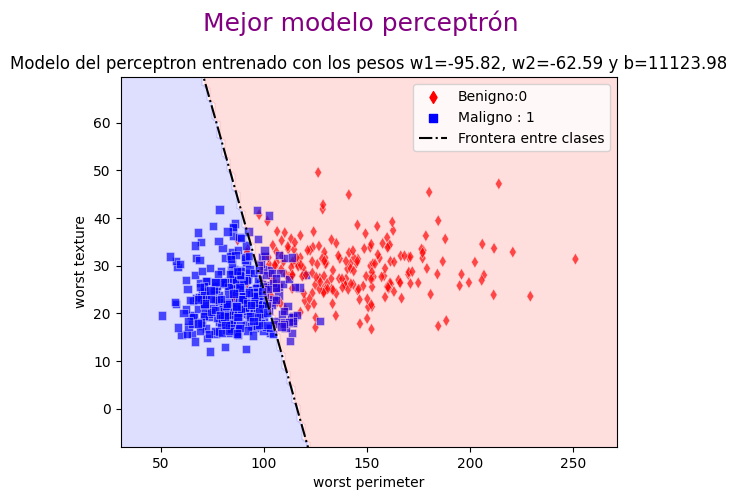

In [77]:
grafico_perceptron(X_par_selec,y_unipolar,modelo_optimo)
plt.suptitle("Mejor modelo perceptrón",fontsize = 18,color= "purple",x=0.5,y=1.02)
plt.show()

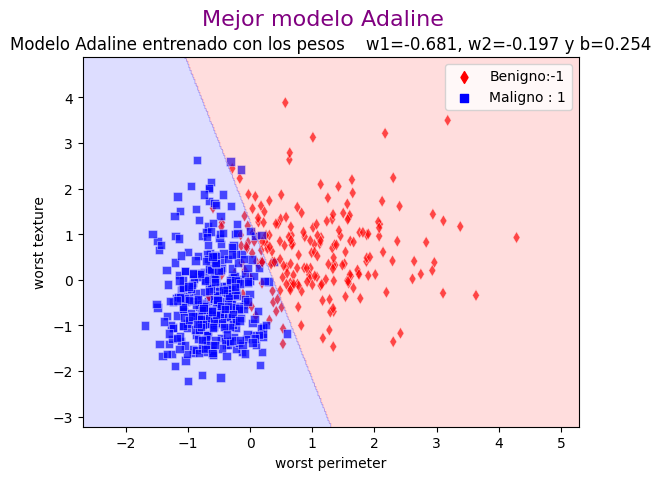

In [78]:
grafico_adaline(X_par_selec_normalizadas,y_bipolar,adaline_mejor)
plt.suptitle("Mejor modelo Adaline",fontsize=16,color="purple")
plt.show()